In [1]:
if not "__WDSET__" in globals():
    %cd -q ../..
    __WDSET__ = True

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from tqdm.auto import tqdm

from wsfr_read.config import DATA_ROOT
from core.models.utils import Vector

2024-01-13 01:09:38.508 | INFO     | wsfr_read.config:<module>:10 - DATA_ROOT is /Users/nsarang/Nimas/water-supply-forecast-rodeo-runtime/data


In [4]:
from core.datasets import *

2024-01-13 01:09:39.855 | INFO     | core.config:<module>:27 - DATA_ROOT is /Users/nsarang/Nimas/water-supply-forecast-rodeo-runtime/data
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/dask/dataframe/_pyarrow_compat.py:23: UserWarning: You are using pyarrow version 12.0.1 which is known to be insecure. See https://www.cve.org/CVERecord?id=CVE-2023-47248 for further details. Please upgrade to pyarrow>=14.0.1 or install pyarrow-hotfix to patch your current version.
  warnings.warn(


In [5]:
df_forecast_monthly = pd.read_csv(DATA_ROOT / "forecast_train_monthly_naturalized_flow.csv")
df_forecast_targets = pd.read_csv(DATA_ROOT / "forecast_train.csv")

In [6]:
metadata = get_metadata(supplements=True).rename(columns={"area": "basins_area"})

df_train_monthly = pd.read_csv(DATA_ROOT / "train_monthly_naturalized_flow.csv")
df_test_monthly = pd.read_csv(DATA_ROOT / "test_monthly_naturalized_flow.csv")
df_train_targets = pd.read_csv(DATA_ROOT / "train.csv")
df_submission = pd.read_csv(DATA_ROOT / "submission_format.csv")

In [7]:
df_supplementary_monthly = pd.read_csv(
    DATA_ROOT / "supplementary_nrcs_train_monthly_naturalized_flow.csv"
)
df_supplementary_monthly = df_supplementary_monthly.merge(
    metadata[["site_id", "nrcs_id", "season_start_month", "season_end_month"]],
    on="nrcs_id",
).drop(columns="nrcs_id")

df_supplementary_targets = (
    df_supplementary_monthly.dropna()
    .query("month >= season_start_month & month <= season_end_month")
    .groupby(["site_id", "forecast_year"])["volume"]
    .sum()
    .reset_index()
    .rename(columns={"forecast_year": "year"})
)

In [8]:
# OPTION 1: Training set + approximated test set
# df_test_targets_v2 = (
#     df_test_monthly.merge(metadata, on="site_id")
#     .groupby(["site_id", "forecast_year"])
#     .apply(
#         lambda df: df[df["month"].between(df["season_start_month"], df["season_end_month"])][
#             "volume"
#         ].sum()
#     )
#     .reset_index(name="volume")
# )
# df_train_targets_v2 = (
#     df_train_monthly.merge(metadata, on="site_id")
#     .groupby(["site_id", "forecast_year"])
#     .apply(
#         lambda df: df[df["month"].between(df["season_start_month"], df["season_end_month"])][
#             "volume"
#         ].sum()
#     )
#     .reset_index(name="volume")
# )
# df_monthly = pd.concat((df_train_monthly, df_test_monthly))
# df_targets = pd.concat((df_train_targets_v2, df_test_targets_v2)).rename(
#     columns={"forecast_year": "year"}
# )


# OPTION 2: Training set
# df_monthly = df_train_monthly
# df_targets = df_train_targets


# OPTION 3: Training + test + supplemental
df_monthly = pd.concat((df_forecast_monthly, df_supplementary_monthly))
df_targets = pd.concat((df_forecast_targets, df_supplementary_targets))

In [9]:
df_monthly["date"] = df_monthly[["year", "month"]].apply(
    lambda r: datetime(r["year"], r["month"], 1), axis=1
)

# Data

In [10]:
issue_dates = pd.to_datetime(df_submission["issue_date"]).unique()
all_month_day_combos = np.stack(np.unique([issue_dates.month, issue_dates.day], axis=1), axis=1)
# all_month_day_combos = all_month_day_combos[0, np.newaxis]

all_years = np.unique(
    np.concatenate(
        (
            issue_dates.year,
            df_monthly["forecast_year"],
            df_targets["year"],
        )
    )
)

ALL_ISSUE_DATES = pd.Series(
    [datetime(year, month, day) for year in all_years for (month, day) in all_month_day_combos],
    name="issue_date",
)
ALL_ISSUE_DATES

0      1850-01-01
1      1850-01-08
2      1850-01-15
3      1850-01-22
4      1850-02-01
          ...    
4867   2023-06-22
4868   2023-07-01
4869   2023-07-08
4870   2023-07-15
4871   2023-07-22
Name: issue_date, Length: 4872, dtype: datetime64[ns]

In [11]:
# import os
# os.makedirs(DATA_ROOT / "cache" / "snotel", exist_ok=True)

# for year in tqdm(all_years):
#     year_issue_dates = ALL_ISSUE_DATES[ALL_ISSUE_DATES.dt.year == year]
#     year_snotel = get_snotel_features(
#         year_issue_dates, max_distance_km=150, lookback=15, add_features=True, df_metadata=metadata
#     )
#     year_snotel.to_csv(DATA_ROOT / "cache" / "snotel"/ f"snotel_features_FY{year}.csv", index=False)

In [12]:
# import os
# os.makedirs(DATA_ROOT / "cache" / "cdec", exist_ok=True)

# for year in tqdm(all_years):
#     year_issue_dates = ALL_ISSUE_DATES[ALL_ISSUE_DATES.dt.year == year]
#     year_cdec = get_cdec_data(year_issue_dates, lookback=15, max_distance_km=150, df_metadata=metadata)
#     year_cdec.to_csv(DATA_ROOT / "cache" / "cdec"/ f"cdec_features_FY{year}.csv", index=False)

In [13]:
# import os

# os.makedirs(DATA_ROOT / "cache" / "pdsi", exist_ok=True)
# os.makedirs(DATA_ROOT / "cache" / "cpc", exist_ok=True)

# merge_dfs = lambda l: (pd.concat(l) if len(l) else pd.DataFrame())

# for year in tqdm(all_years):
#     df_pdsi, df_cpc = [], []
#     year_issue_dates = ALL_ISSUE_DATES[ALL_ISSUE_DATES.dt.year == year]

#     if os.path.isfile(DATA_ROOT / "cache" / "cpc" / f"cpc_features_FY{year}.csv"):
#         continue

#     for issue_date in year_issue_dates:
#         df_pdsi.append(
#             get_pdsi_features(
#                 issue_date, radius1_km=50, radius2_km=200, df_metadata=metadata
#             ).assign(issue_date=issue_date)
#         )
#         df_cpc.append(get_cpc_data(issue_date, df_metadata=metadata).assign(issue_date=issue_date))

#     df_pdsi = merge_dfs(df_pdsi)
#     df_cpc = merge_dfs(df_cpc)

#     df_pdsi.to_csv(DATA_ROOT / "cache" / "pdsi" / f"pdsi_features_FY{year}.csv", index=False)
#     df_cpc.to_csv(DATA_ROOT / "cache" / "cpc" / f"cpc_features_FY{year}.csv", index=False)

In [14]:
# df_pdsi, df_snotel, df_cpc, df_cdec, df_grace = [[] for _ in range(5)]

# for issue_date in tqdm(ALL_ISSUE_DATES):
#     df_pdsi.append(
#         get_pdsi_features(issue_date, radius1_km=50, radius2_km=200, df_metadata=metadata).assign(
#             issue_date=issue_date
#         )
#     )
#     df_snotel.append(
#         get_snotel_features(
#             issue_date, max_distance_km=150, lookback=15, df_metadata=metadata
#         ).assign(issue_date=issue_date)
#     )
#     df_cpc.append(get_cpc_data(issue_date, df_metadata=metadata).assign(issue_date=issue_date))
#     df_cdec.append(
#         get_cdec_data(issue_date, lookback=30, max_distance_km=70, df_metadata=metadata).assign(
#             issue_date=issue_date
#         )
#     )
#     # df_grace.append(get_grace_features(issue_date, radius1_km=50, radius2_km=200).assign(issue_date=issue_date))

# df_pdsi, df_snotel, df_cpc, df_cdec, df_grace = map(
#     lambda l: (pd.concat(l) if len(l) else pd.DataFrame()),
#     [df_pdsi, df_snotel, df_cpc, df_cdec, df_grace],
# )

In [15]:
teleconn_data = get_all_teleconnections_data()
for k, v in teleconn_data.items():
    v.columns = v.columns.str.replace("[ \.]", "_", regex=True)
    teleconn_data[k] = v

# Assemble

In [16]:
issues = metadata.merge(ALL_ISSUE_DATES, how="cross").query(
    "issue_date.dt.month <= season_end_month"
)

issues = (
    issues.merge(
        df_targets,
        left_on=["site_id", issues["issue_date"].dt.year],
        right_on=["site_id", "year"],
    )
    .rename(columns={"year": "forecast_year"})
    .dropna(subset="volume")
)

In [17]:
import warnings
import re

filter_messages = [
    "`meta` is not specified, inferred from partial data.",
    "is_categorical_dtype is deprecated and will be removed in a future version",
    "'PYARROW_IGNORE_TIMEZONE' environment variable was not set. It is required to set this environment variable to '1' in both driver and executor sides if you use pyarrow>=2.0.0.",
]

for msg in filter_messages:
    warnings.filterwarnings(
        "ignore",
        message=f".*{re.escape(msg)}.*",
    )

In [18]:
import os
from pyspark.sql import SparkSession
from core.data.spark import *

# os.environ["PYSPARK_PYTHON"] = "/usr/bin/python3"  # Path to Python, adjust as needed
os.environ["PYSPARK_DRIVER_PYTHON"] = "jupyter"
os.environ["PYSPARK_DRIVER_PYTHON_OPTS"] = "notebook"
os.environ[
    "PYSPARK_SUBMIT_ARGS"
] = "--conf spark.executor.extraJavaOptions=-Dlog4jspark.root.logger=ERROR,console pyspark-shell"

spark = default_session(
    {"spark.executor.extraJavaOptions": "-Dlog4jspark.root.logger=WARN,console"}
)
spark.sparkContext.setLogLevel("ERROR")

Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
24/01/13 01:10:07 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


In [19]:
from core.data.utils import _dx_cross_merge
from core.tools.shutup import mute_warnings
from core.data.feature import generate_timeseries_features_v3


def psdf_postprocess(df):
    df = df.reset_index()
    df["issue_date"] = pd.to_datetime(df["issue_date"])
    return df


enrichment_fns = {
    "roll_max5": lambda c: c.rolling(window=5, min_periods=1).max(),
    "roll_min5": lambda c: c.rolling(window=5, min_periods=1).min(),
    "roll_mean5": lambda c: c.rolling(window=5, min_periods=1).mean(),
    "roll_std7": lambda c: c.rolling(window=5, min_periods=2).std(),
    "ewm_mean7": lambda c: c.ewm(span=7).mean(),
    "autocorr": lambda c: c.corr(c.shift(1), min_periods=3),
    "count7": lambda c: c.iloc[-7:].count(),
}

feature_engineering = {
    "MJO": (
        [
            "INDEX_1",
            "INDEX_2",
            "INDEX_3",
            "INDEX_4",
            "INDEX_5",
            "INDEX_6",
            "INDEX_7",
            "INDEX_8",
            "INDEX_9",
            "INDEX_10",
        ],
        ["INDEX_2", "INDEX_5"],
    ),
    "PDO": (["pdo_index"], ["pdo_index"]),
    "NINO": (
        [
            "NINO1+2",
            "NINO1+2_ANOM",
            "NINO3",
            "NINO3_4",
            "NINO3_4_ANOM",
            "NINO3_ANOM",
            "NINO4",
            "NINO4_ANOM",
        ],
        [],
    ),
    "ONI": (["ANOM", "TOTAL"], ["ANOM"]),
    "PNA": (["pna_index"], ["pna_index"]),
    "SOI": (["soi"], ["soi"]),
}


os.makedirs(DATA_ROOT / "cache" / "televol", exist_ok=True)

for month, day in tqdm(all_month_day_combos):
    pdf_issues = issues[["site_id", "issue_date", "forecast_year"]][
        (issues["issue_date"].dt.month == month) & (issues["issue_date"].dt.day == day)
    ]
    sdf_issues = to_sdf(pdf_issues)

    if not os.path.isfile(DATA_ROOT / "cache" / "televol" / f"volume_features_MMDD_{month}_{day}.csv"):
        volume_features = (
            join_sdf(
                sdf_issues,
                to_sdf(df_monthly),
                on=(
                    (f.col("l.site_id") == f.col("r.site_id"))
                    & (f.col("l.forecast_year") == f.col("r.forecast_year"))
                    & ~(
                        (f.year("date") == f.year("issue_date"))
                        & (f.month("date") >= f.month("issue_date"))
                    )
                ),
                suffixes=("", "_m"),
            )
            .pandas_api()
            .groupby(["site_id", "issue_date"])
            .apply(
                generate_timeseries_features_v3,
                date_col="date",
                features=["volume"],
                enrichments={"volume": enrichment_fns},
            )
            .to_pandas()
            .reset_index()
        )
        volume_features.to_csv(DATA_ROOT / "cache" / "televol" / f"volume_features_MMDD_{month}_{day}.csv", index=False)

    teleconn_features = {}
    for name, df_teleconn in teleconn_data.items():
        if not os.path.isfile(DATA_ROOT / "cache" / "televol" / f"{name}_features_MMDD_{month}_{day}.csv"):
            features, enrich_cols = feature_engineering[name]
            with mute_warnings:
                sdf_features = (
                    join_sdf(
                        sdf_issues.select("issue_date").distinct(),
                        to_sdf(df_teleconn),
                        on=f.col("l.issue_date") > f.col("r.date"),
                        suffixes=("", "_m"),
                    )
                    .pandas_api()
                    .groupby(["issue_date"])
                    .apply(
                        generate_timeseries_features_v3,
                        date_col="date",
                        enrichments={c: enrichment_fns for c in enrich_cols},
                        features=features,
                    )
                    .to_pandas()
                    .reset_index()
                )
                # teleconn_features[name] = sdf_features
                sdf_features.to_csv(DATA_ROOT / "cache" / "televol" / f"{name}_features_MMDD_{month}_{day}.csv", index=False)

  0%|          | 0/28 [00:00<?, ?it/s]

/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/sql/pandas/conversion.py:485: FutureWarning: is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.
  if should_localize and is_datetime64tz_dtype(s.dtype) and s.dt.tz is not None:
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/sql/pandas/conversion.py:485: FutureWarning: is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.
  if should_localize and is_datetime64tz_dtype(s.dtype) and s.dt.tz is not None:
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/sql/pandas/conversion.py:485: FutureWarning: is_datetime64tz_dtype is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.DatetimeTZDtype)` instead.
  if should_localize and is_datetime64tz_dtype(s.dtype) and s.dt.tz is

/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/python/lib/pyspark.zip/pyspark/sql/pandas/serializers.py:224: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/python/lib/pyspark.zip/pyspark/sql/pandas/serializers.py:224: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/python/lib/pyspark.zip/pyspark/sql/pandas/serializers.py:224: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/pyspark/python/lib/pyspark.zip/pyspark/sql/pandas/serializers.py:224: FutureWarning: is_c

In [29]:
equivs = {
    "SNOW WC": "WTEQ_DAILY",
    "RAIN": "PREC_DAILY",
    "SNOW DP": "SNWD_DAILY",
    "TEMP MN": "TMIN_DAILY",
    "TEMP MX": "TMAX_DAILY",
    "TEMP AV": "TAVG_DAILY",
}

df_cdec_ = df_cdec.copy()
df_cdec_ = df_cdec.rename(columns={f"value_{col}": col_eq for col, col_eq in equivs.items()})
for attr in ["latitude", "longitude", "distance", "elevation", "count"]:
    if attr == "count":
        df_cdec_[f"stations_{attr}"] = df_cdec_[[f"{attr}_{col}" for col in equivs]].mean(
            axis=1, skipna=True
        )
    else:
        df_cdec_[f"{attr}_station"] = df_cdec_[[f"{attr}_station_{col}" for col in equivs]].mean(
            axis=1, skipna=True
        )
df_cdec_ = df_cdec_[[c for c in df_snotel.columns if c in df_cdec_.columns]]
df_snotel_plus = pd.concat((df_snotel, df_cdec_)).drop_duplicates(
    subset=["site_id", "issue_date"], keep="first"
)

In [30]:
from functools import reduce

dataset_final = reduce(
    lambda x, y: x.merge(
        psdf_postprocess(y), on=["site_id", "issue_date"], how="left", suffixes=("", "_f")
    ),
    [
        issues,
        volume_features,
        # df_snotel,
        df_cpc,
        df_pdsi,
        # df_cdec,
        df_snotel_plus,
    ],
)

dataset_final = reduce(
    lambda x, y: x.merge(psdf_postprocess(y), on=["issue_date"], how="left", suffixes=("", "_f")),
    [dataset_final, *list(teleconn_features.values())],
)

# Split

In [ ]:
# from core.data_loader import prepare_dataset

# tqdm.pandas()

# dataset_prod = prepare_dataset(
#     month=1,
#     day=1,
#     df_monthly_flow=df_forecast_monthly,
#     df_targets=df_forecast_targets.rename(columns={"year": "forecast_year"}),
# )

# dataset_orig.to_pickle("cache/dataset_v1")
# dataset = pd.read_pickle("cache/dataset_v1")

In [32]:
# import xgboost as xgb
import lightgbm as lgb
import catboost as cb
from sklearn.model_selection import train_test_split

In [33]:
# from core.submission import prepare_dataset
# dataset = prepare_dataset("2023-03-15", df_monthly_data=df_monthly, df_targets=df_targets)

In [34]:
dataset_orig = dataset_final.copy()

In [35]:
len(dataset_orig)

41015

In [36]:
dataset = dataset_orig.copy()
# dataset = dataset_prod.copy()
# dataset.columns = dataset.columns.str.replace("[ \.]", "_", regex=True)
dataset = dataset[dataset["forecast_year"] > 1950]
# dataset = dataset[(dataset["issue_date"].dt.month == 1) & (dataset["issue_date"].dt.day == 22)]
dataset = dataset[(dataset["volume"] > 0) & (dataset["volume"].notnull())]
dataset["issue_month"] = dataset.issue_date.dt.month

primary_sites = get_metadata()["site_id"].to_numpy()
cali_sites = [
    "merced_river_yosemite_at_pohono_bridge",
    "american_river_folsom_lake",
    "san_joaquin_river_millerton_reservoir",
]
# dataset = dataset[~dataset.site_id.isin(cali_sites)]
# dataset = dataset[dataset.site_id.isin(primary_sites)]


# dataset = dataset_orig.copy()
# dataset = dataset.query("site_id == 'libby_reservoir_inflow' | site_id == 'snake_r_nr_heise'")

In [38]:
df_cpc

,precip_score,precip_sd,temp_mean,temp_sd,issue_date,site_id
0,2.258978,0.380020,59.548500,1.417495,1995-01-01,$_Ahtanum_Ck_at_Union_Gap
1,2.476382,0.411158,60.722500,1.366400,1995-01-01,$_Alamosa_Ck_ab_Terrace_Reservoir
2,1.869569,0.428217,64.474167,1.483392,1995-01-01,$_American_Fk_ab_Upper_Powerplant
3,1.113063,0.206590,65.117500,1.368440,1995-01-01,$_American_R_A_Fair_Oaks_CA
4,2.402298,0.411319,59.438125,1.420169,1995-01-01,$_American_R_nr_Nile
...,...,...,...,...,...,...
595,2.585515,0.530000,60.602500,1.787600,2023-01-01,sweetwater_r_nr_alcova
596,2.498092,0.407500,62.663125,1.638813,2023-01-01,taylor_park_reservoir_inflow
597,1.417155,0.268250,70.745500,1.781900,2023-01-01,virgin_r_at_virtin
598,1.512543,0.265000,63.385000,1.861792,2023-01-01,weber_r_nr_oakley


In [37]:
dataset["yr_in_2yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 2
dataset["yr_in_3yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 3
dataset["yr_in_4yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 4

# Fourier series components for 4-year seasonality
num_terms = 1  # Number of Fourier terms
for n in range(1, num_terms + 1):
    for cycle in [2, 3, 4]:
        dataset[f"sin_yr{cycle}_{n}"] = np.sin(
            2 * np.pi * n * dataset[f"yr_in_{cycle}yr_cycle"] / cycle
        )
        dataset[f"cos_yr{cycle}_{n}"] = np.cos(
            2 * np.pi * n * dataset[f"yr_in_{cycle}yr_cycle"] / cycle
        )

In [304]:
X, y = (
    dataset[
        [
            "site_id",
            "basins_area",
            "elevation",
            "latitude",
            "longitude",
            "issue_month",
            # "drainage_area",
            # "volume_10",
            # "volume_11",
            # "volume_12",
            # "volume_1",
        ]
        + [
            f"{fn}_yr{cycle}_{n}"
            for n in range(1, num_terms + 1)
            for cycle in [2, 3]
            for fn in ["sin", "cos"]
        ]
        # + [f"INDEX_{i + 1}" for i in range(10)]  # MJO
        # + [
        #     "NINO1+2",
        #     "NINO1+2_ANOM",
        #     "NINO3",
        #     "NINO3_ANOM",
        #     "NINO4",
        #     "NINO4_ANOM",
        #     "NINO3_4",
        #     "NINO3_4_ANOM",
        # ]  # NINO
        + ["ANOM", "TOTAL"]  # ONI
        + ["pdo_index", "pna_index", "soi"]  # PDO PNA SOI
        + [
            "PREC_DAILY",
            "SNWD_DAILY",
            "WTEQ_DAILY",
            "elevation_station",
            # "latitude_station",
            # "longitude_station",
            # "distance_station",
            # "stations_count",
        ]
        + df_snotel_plus.columns[8:18].tolist()
        + ["TAVG_DAILY", "TMAX_DAILY", "TMIN_DAILY"]
        # + [
        #     f + suffix
        #     for f in [
        #         "PREC_DAILY",
        #         "SNWD_DAILY",
        #         "WTEQ_DAILY",
        #     ]
        #     for suffix in ["_in-basin", "_out-basin"]
        # ]
        + ["INDEX_2", "INDEX_5", "NINO1+2_ANOM", "NINO4"]
        + ["pdsi_1", "pdsi_2"]
        + ["precip_score", "temp_mean"] # + ["precip_sd", "temp_sd"]
        # + ["gws_inst_1", "rtzsm_inst_1", "sfsm_inst_1",	"gws_inst_2", "rtzsm_inst_2", "sfsm_inst_2"]
        + [
            c + "_" + suffix
            for c in sum(
                map(
                    lambda x: x[1],
                    {
                        k: v for k, v in feature_engineering.items() if k not in ["MJO", "NINO"]
                    }.values(),
                ),
                ["volume"],
            )
            for suffix in list_sub(enrichment_fns, ["count7"])
        ]
    ].copy(),
    dataset["volume"].copy(),
)


# X["V"] = dataset.loc[X.index]["volume_roll_mean5"] / (X["basins_area"].values ** 2)
# X["month"] = dataset.loc[X.index]["issue_date"].dt.month

# elim_feats = [
#     "pdo_index_autocorr",
#     "pna_index_roll_mean5",
#     "pna_index_roll_max5",
#     "soi_autocorr",
#     "soi_roll_std7",
#     "pna_index_ewm_mean7",
#     "TOTAL",
#     "NINO1+2 ANOM",
#     "SNWD_DAILY",
#     #  'ANOM',
#     "ANOM_roll_std7",
#     "pdo_index_roll_max5",
#     "ANOM_roll_max5",
#     "pdo_index",
#     "pna_index_autocorr",
#     "pna_index_roll_std7",
#     "INDEX_2",
#     "ANOM_ewm_mean7",
# ]

elim_feats = [
    # "ANOM",
    # "ANOM_autocorr",
    # "ANOM_ewm_mean7",
    "ANOM_roll_max5",
    "ANOM_roll_mean5",
    "ANOM_roll_min5",
    "ANOM_roll_std7",
    # "INDEX_2",
    # "INDEX_5",
    # "NINO1+2_ANOM",
    "NINO4",
    # "SNWD_DAILY",
    # "TAVG_DAILY",
    # "TMAX_DAILY",
    # "TMIN_DAILY",
    "cos_yr3_1",
    # "elevation",
    "elevation_station",
    # "pdo_index",
    "pdo_index_autocorr",
    "pdo_index_ewm_mean7",
    "pdo_index_roll_max5",
    "pdo_index_roll_mean5",
    # "pdo_index_roll_min5",
    "pdo_index_roll_std7",
    # "pdsi_1",
    # "pdsi_2",
    # "pna_index",
    "pna_index_ewm_mean7",
    # "pna_index_roll_max5",
    "pna_index_roll_mean5",
    "pna_index_roll_std7",
    "soi_autocorr",
    "soi_ewm_mean7",
    "soi_roll_max5",
    "soi_roll_mean5",
    "soi_roll_min5",
    "soi_roll_std7",
    "volume_autocorr"
]


X = X[X.columns.difference(elim_feats)]
# X = X[X.columns[[0] + summary["selected_features"]]]


is_test = ~dataset["forecast_year"].isin(df_train_targets["year"]).to_numpy()
X_test = X[is_test].copy()
y_test = y[is_test].copy()
X = X[~is_test].copy()
y = y[~is_test].copy()


site_codes = dataset.loc[X.index]["site_id"].astype("category").cat.codes

# FY WEIGHT
start_year = 2000
fy_weight = np.full(len(X), 1)
fy_weight[dataset.loc[X.index]["forecast_year"] >= start_year] = (
    0.5
    * dataset.loc[X.index]["forecast_year"].nunique()
    / (dataset.loc[X.index]["forecast_year"].unique() >= start_year).sum()
)

from core.data.preprocess import minmax_norm


site_weights = dataset.loc[X.index].groupby("site_id")["volume"].mean().rename("vol_mean")
site_weights = np.sqrt(site_weights)
site_weights[site_weights.index.isin(primary_sites)] *= 30
site_weights = minmax_norm(site_weights, baseline=0.001, scale=4)
# site_weights = site_weights / site_weights.sum()

instance_weight = (
    dataset.loc[X.index]
    .rename_axis("__index__")
    .reset_index()
    .merge(site_weights, on="site_id", how="left")
    .set_index("__index__")
    .loc[X.index]["vol_mean"]
    .values
)
# instance_weight = dataset.loc[X.index]["basins_area"].values
# instance_weight = np.full(len(dataset), 1)

combined_weight = fy_weight * instance_weight
# X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=site_codes, random_state=None)

In [305]:
# import pandas as pd
# # pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)
# pd.set_option('display.width', 1000)
# null_feats = dataset.groupby("site_id").apply(lambda df: df.isnull().mean())
# null_feats

In [306]:
group_codes = (
    (
        dataset.loc[X.index]["site_id"]
        + "_"
        + (dataset.loc[X.index]["issue_date"].dt.year // 10).astype("str")
    )
    .astype("category")
    .cat.codes
)

# Train

In [375]:
custom_feature_weights = {
    "site_id": 1,
    # "elevation": 1,
    # "V": 1,
}

feature_weights = np.full(X.shape[1], 1.0)
for k, v in custom_feature_weights.items():
    feature_weights[X.columns.get_loc(k)] = v


default_model_params = dict(
    # n_estimators=1000,
    learning_rate=0.03,
    depth=6,
    colsample_bylevel=0.6,
    subsample=0.66,
    l2_leaf_reg=0,
    random_strength=0.5,
    feature_weights=feature_weights,
    silent=True,
)

aggressive_model_params = dict(
    n_estimators=100,
    # learning_rate=0.03,
    # depth=10,
    # colsample_bylevel=0.6,
    # subsample=0.66,
    l2_leaf_reg=0,
    random_strength=0,
    # feature_weights=feature_weights,
    # silent=True,
)

In [376]:
REAL_TEST = True

In [386]:
from core.objectives.rmq import RmseQuantilieObjective, RmseQuantilieMetric
from sklearn.model_selection import StratifiedKFold, StratifiedGroupKFold
from collections import defaultdict
from core.data.preprocess import DataProcessor, minmax_norm
from core.models.catboost import train_catboost
from core.models.nn.train import train_nn
from core.train import InferenceEngine
from core.objectives.pinball import pinball_loss

mql_loss = lambda *args, weight, alpha=0.5: 2 * np.average(
    pinball_loss(*args, alpha=alpha), weights=weight
)
skfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1234)
sgkfold = StratifiedGroupKFold(n_splits=5, shuffle=True, random_state=1234)
logs = defaultdict(list)



for idx, (train_index, test_index) in enumerate(sgkfold.split(X, site_codes, group_codes)):
    if REAL_TEST:
        X_train, X_val = X.iloc[train_index].copy(), X_test.copy()
        y_train, y_val = y.iloc[train_index].copy(), y_test.copy()
        weight_train = combined_weight[train_index].copy()
        weight_val = np.full(len(X_val), 1)
    else:
        X_train, X_val = X.iloc[train_index].copy(), X.iloc[test_index].copy()
        y_train, y_val = y.iloc[train_index].copy(), y.iloc[test_index].copy()

        weight_train, weight_val = (
            combined_weight[train_index].copy(),
            combined_weight[test_index].copy(),
        )

    cond = X_val.site_id.isin(primary_sites)
    X_val = X_val[cond]
    y_val = y_val[cond]
    weight_val = weight_val[cond]

    # model, data_processor, _, _ = train_catboost(
    #     X_train, y_train, X_val, y_val, weight_train, weight_val, **aggressive_model_params
    # )
    # _preprocess = None

    (
        model,
        data_processor,
        error_val,
        _,
    ) = train_nn(
        X_train,
        y_train,
        X_val,
        y_val,
        weight_train,
        weight_val,
        epochs=25,
        early_stopping_patience=5,
        learning_rate=0.00075,
        weight_decay=1,
        batch_size=256,
        scheduler_step_size=7,
        scheduler_gamma=0.75,
        model_config=dict(
            hidden_size=12,
            num_hidden_layers=1,
            num_attention_heads=4,
            hidden_dropout_prob=0,
            attention_probs_dropout_prob=0,
        ),
        **aggressive_model_params
    )
    def _preprocess(X):
        X["site_id-2"] = X["site_id"]
        cats = ["site_id-2"]
        columns = cats + [c for c in X.columns if c not in cats]
        X = X[columns]
        return X

    infernce_engine = InferenceEngine(model, data_processor, preprocess_fn=_preprocess)
    y_train_pred = infernce_engine(X_train)
    y_val_pred = infernce_engine(X_val)

    logs["train_index"].append(X_train.index)
    logs["val_index"].append(X_val.index)
    logs["train_pred"].append(y_train_pred)
    logs["val_pred"].append(y_val_pred)
    logs["data_processor"] += [data_processor]
    logs["models"] += [model]
    logs["inference_model"] += [infernce_engine]

Epoch 1/25 - Train loss: 0.1740 - Val loss: 0.4650
Epoch 2/25 - Train loss: 0.1391 - Val loss: 0.4984
Epoch 3/25 - Train loss: 0.1332 - Val loss: 0.5092
Epoch 4/25 - Train loss: 0.1292 - Val loss: 0.5097
Epoch 5/25 - Train loss: 0.1253 - Val loss: 0.5216
Epoch 6/25 - Train loss: 0.1187 - Val loss: 0.5358
Early stopping triggered.
Epoch 1/25 - Train loss: 0.1663 - Val loss: 0.4610
Epoch 2/25 - Train loss: 0.1384 - Val loss: 0.4762
Epoch 3/25 - Train loss: 0.1334 - Val loss: 0.4842
Epoch 4/25 - Train loss: 0.1284 - Val loss: 0.4725
Epoch 5/25 - Train loss: 0.1236 - Val loss: 0.4606
Epoch 6/25 - Train loss: 0.1189 - Val loss: 0.4840
Epoch 7/25 - Train loss: 0.1149 - Val loss: 0.4788
Epoch 8/25 - Train loss: 0.1119 - Val loss: 0.4910
Epoch 9/25 - Train loss: 0.1097 - Val loss: 0.4887
Epoch 10/25 - Train loss: 0.1091 - Val loss: 0.5111
Early stopping triggered.
Epoch 1/25 - Train loss: 0.1744 - Val loss: 0.4439
Epoch 2/25 - Train loss: 0.1412 - Val loss: 0.4545
Epoch 3/25 - Train loss: 0.13

In [387]:
mlpo_config = dict(
    epochs=25,
    early_stopping_patience=5,
    learning_rate=0.00075,
    weight_decay=1,
    batch_size=256,
    scheduler_step_size=5,
    scheduler_gamma=0.75,
)

transformer_config = dict(
    epochs=25,
    early_stopping_patience=5,
    learning_rate=0.00075,
    weight_decay=1,
    batch_size=256,
    scheduler_step_size=5,
    scheduler_gamma=0.75,
    model_config=dict(
        hidden_size=12,
        num_hidden_layers=1,
        num_attention_heads=4,
        hidden_dropout_prob=0,
        attention_probs_dropout_prob=0,
    ),
)

In [388]:
# # Example usage
# num_categorical_features = 10  # Example value
# num_numerical_features = 5  # Example value
# categorical_embedding_sizes = [(100, 10), (50, 5), ...]  # Define based on your data

# model = TabularTransformer(
#     num_numerical_features=5, categorical_embedding_sizes=[27], hidden_size=128, output_size=3
# )
# sum([p.numel() for p in transformer.parameters()])

In [389]:
# X_test22 = X_test.copy()
# X_test22["site_id"] = X_test22["site_id"].astype("category").cat.codes + 1

# from core.models.mlp import to_torch

# cat_feats = X_test22["site_id"]
# num_feats = X_test22[[c for c in X_test22.columns if c not in ["site_id"]]]

# cat_feats = to_torch(cat_feats.values, dtype=torch.long)[..., None]
# num_feats = to_torch(num_feats.values, dtype=torch.float32)

In [390]:
train_loc = np.concatenate(logs["train_index"])
val_loc = np.concatenate(logs["val_index"])
y_pred_train = np.concatenate(logs["train_pred"], axis=1)
y_pred_val = np.concatenate(logs["val_pred"], axis=1)

train_index = X.index.get_indexer_for(train_loc)
y_all = y.to_numpy()
y_gt_train = y_all[train_index]
fy_weight_train = fy_weight[train_index]


if REAL_TEST:
    val_index = np.arange(len(y_pred_val[0]))
    # y_gt_val = y_test.to_numpy()[val_index]
    y_gt_val = np.tile(y_test.to_numpy(), 5)
    fy_weight_val = np.full(len(val_index), 1)
else:
    val_index = X.index.get_indexer_for(val_loc)
    y_gt_val = y_all[val_index]
    fy_weight_val = fy_weight[val_index]

models = logs["models"][-1]

Text(0.5, 1.0, 'Train Mean: 127.6\nVal Mean: 175.4')

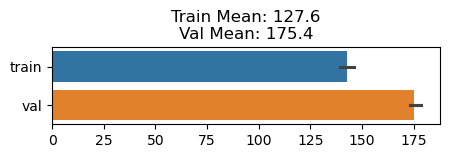

In [392]:
# error_train = 2 * pinball_loss(y_gt_train, y_pred_train[0], alpha=0.5)
# error_val = 2 * pinball_loss(y_gt_val, y_pred_val[0], alpha=0.5)


# quantiles = [0.5]
quantiles = [0.1, 0.5, 0.9]

error_train = 2 * np.stack(
    [pinball_loss(y_gt_train, y_pred_train[i], alpha=q) for i, q in enumerate(quantiles)], axis=1
).mean(axis=1)
# error_val = 2 * np.stack([pinball_loss(y_gt_val, y_pred_val[i], alpha=q) for i, q in enumerate(quantiles)], axis=1).mean(axis=1)
error_val = 2 * np.stack(
    [pinball_loss(y_gt_val, y_pred, alpha=q) for y_pred, q in zip(y_pred_val, [0.1, 0.5, 0.9])],
    axis=1,
).mean(axis=1)

train_lengths = np.cumsum([0] + list(map(len, logs["train_index"])))
val_lengths = np.cumsum([0] + list(map(len, logs["val_index"])))


error_train_folds = np.array(
    [
        np.average(error_train[train_index[l:r]], weights=fy_weight_train[train_index[l:r]])
        for l, r in zip(train_lengths[:-1], train_lengths[1:])
    ]
)
error_val_folds = np.array(
    [
        np.average(error_val[val_index[l:r]], weights=fy_weight_val[val_index[l:r]])
        for l, r in zip(val_lengths[:-1], val_lengths[1:])
    ]
)

plt.figure(figsize=(5, 1))
sns.barplot(pd.DataFrame({"train": error_train_folds, "val": error_val_folds}), orient="h")
plt.title(
    # f"Results\n"
    f"Train Mean: {np.average(error_train, weights=fy_weight_train):.1f}\n"
    f"Val Mean: {np.average(error_val, weights=fy_weight_val):.1f}"
)

In [342]:
from core.train import Ensemble
from core import recipes

quantiles = [0.1, 0.5, 0.9]

model = Ensemble(
    logs["inference_model"],
    # logs["data_processor"],
    # weights=1 / np.array(logs["catboost_error"]),
    # feature_columns=X.columns,
)
# model = logs["models"][-1]

y_pred_val2 = model.predict(X_test)
val_index2 = np.arange(len(y_pred_val2[0]))
# y_gt_val = y_test.to_numpy()[val_index]
y_gt_val2 = y_test.to_numpy()
fy_weight_val = np.full(len(val_index2), 1)


error_train = 2 * np.stack(
    [pinball_loss(y_gt_train, y_pred_train[i], alpha=q) for i, q in enumerate(quantiles)], axis=1
).mean(axis=1)
error_val = 2 * np.stack(
    [pinball_loss(y_gt_val2, y_pred_val2[i], alpha=q) for i, q in enumerate(quantiles)], axis=1
).mean(axis=1)
np.average(error_train, weights=fy_weight_train), error_val.mean()

(131.76312596387598, 175.10871360485234)

In [427]:
import plotly.express as px

# m = models[1]
model = infernce_engine
pred_index = 1

if REAL_TEST:
    # X_test_, _, _ = data_processor.preprocess_transform(X_test, y_test, weight_val, mode="val")
    # y_pred = m.predict(X_test_)
    # y_pred_ = data_processor.postprocess_transform(X_test_, y_pred)
    y_pred_ = model.predict(X_test)[pred_index]
    df_viz = dataset[is_test].copy()
    df_viz["target"] = y_test
    df_viz["pred"] = y_pred_
else:
    fold_index = 1
    df_viz = dataset.loc[logs["val_index"][fold_index]].copy()
    df_viz["target"] = df_viz["volume"]
    df_viz["pred"] = logs["val_pred"][fold_index][0]

# df_viz = df_viz[df_viz.site_id.isin(cali_sites)]

print(2 * pinball_loss(df_viz["target"], df_viz["pred"], alpha=quantiles[pred_index]).mean())
px.line(df_viz, x="forecast_year", y=["target", "pred"], color="site_id")

290.83325182890474


(array([2.5269e+04, 1.1000e+02, 5.0000e+00, 2.7000e+01, 6.6000e+01,
        2.7000e+01, 1.9000e+01, 1.7000e+01, 4.0000e+00, 4.0000e+00]),
 array([1.00000000e-03, 1.37784499e+04, 2.75568988e+04, 4.13353477e+04,
        5.51137966e+04, 6.88922455e+04, 8.26706944e+04, 9.64491433e+04,
        1.10227592e+05, 1.24006041e+05, 1.37784490e+05]),
 <BarContainer object of 10 artists>)

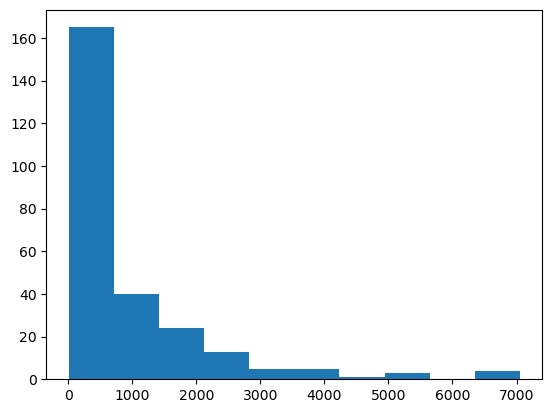

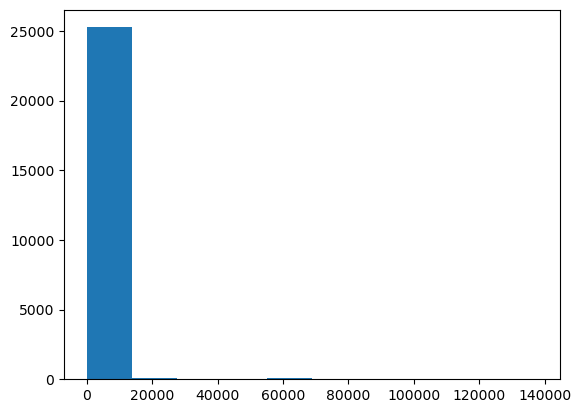

In [428]:
plt.figure(0)
plt.hist(y_val)
plt.figure(1)
plt.hist(y_train)

In [429]:
# masked = ~X.index.isin(X.iloc[train_index].index)
# dataset[masked]
# y[masked]

48.57843343290122

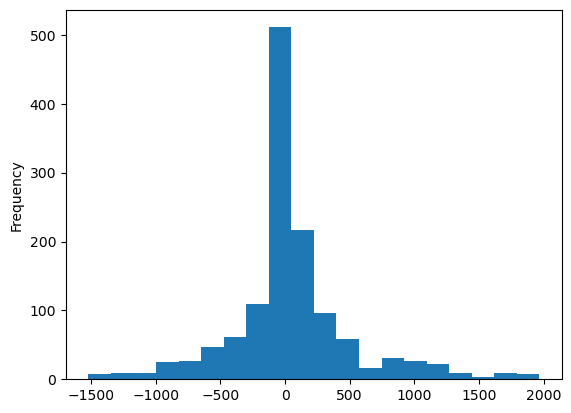

In [433]:
diff = y_gt_val - y_pred_val[1]
# diff = y_gt_train - y_pred_train
pd.Series(diff).plot.hist(bins=20)
diff.mean()

In [434]:
# X_data = dataset.loc[val_loc, ~dataset.columns.duplicated(keep="first")].copy()
df_viz["diff"] = df_viz["target"] - df_viz["pred"]
df_viz["error"] = np.abs(df_viz["diff"])
df_viz["error_normal"] = df_viz["error"] / df_viz["basins_area"]

In [435]:
df_viz.groupby("site_id")["error"].mean().sort_values(ascending=False)

site_id
snake_r_nr_heise                          911.160198
libby_reservoir_inflow                    886.853956
san_joaquin_river_millerton_reservoir     860.916825
american_river_folsom_lake                778.729284
missouri_r_at_toston                      576.579586
boise_r_nr_boise                          503.653032
hungry_horse_reservoir_inflow             440.279852
yampa_r_nr_maybell                        367.765964
fontenelle_reservoir_inflow               320.481139
boysen_reservoir_inflow                   305.808632
merced_river_yosemite_at_pohono_bridge    269.081676
skagit_ross_reservoir                     266.798465
owyhee_r_bl_owyhee_dam                    234.295054
pueblo_reservoir_inflow                   151.102514
stehekin_r_at_stehekin                    118.223267
animas_r_at_durango                       116.514900
detroit_lake_inflow                       108.864708
green_r_bl_howard_a_hanson_dam             59.069447
weber_r_nr_oakley                     

In [436]:
df_viz.groupby("site_id")["error_normal"].mean().sort_values(ascending=False)

site_id
merced_river_yosemite_at_pohono_bridge    0.836026
american_river_folsom_lake                0.464212
san_joaquin_river_millerton_reservoir     0.456303
stehekin_r_at_stehekin                    0.369836
skagit_ross_reservoir                     0.333186
weber_r_nr_oakley                         0.302501
green_r_bl_howard_a_hanson_dam            0.267000
hungry_horse_reservoir_inflow             0.261794
detroit_lake_inflow                       0.240647
boise_r_nr_boise                          0.187417
animas_r_at_durango                       0.166236
snake_r_nr_heise                          0.159310
ruedi_reservoir_inflow                    0.139883
pecos_r_nr_pecos                          0.126702
yampa_r_nr_maybell                        0.108752
dillon_reservoir_inflow                   0.101198
taylor_park_reservoir_inflow              0.100358
libby_reservoir_inflow                    0.098207
fontenelle_reservoir_inflow               0.076320
virgin_r_at_virtin     

In [527]:
df_viz.groupby("site_id")["diff"].mean().sort_values(ascending=False)

site_id
american_river_folsom_lake                138.275015
merced_river_yosemite_at_pohono_bridge     -6.421586
san_joaquin_river_millerton_reservoir     -25.008325
Name: diff, dtype: float64

In [615]:
pd.set_option("display.max_colwidth", 1000)
pd.set_option("display.max_rows", 100)

In [616]:
# px.line(
#     X_data[
#         X_data["site_id"].isin(["libby_reservoir_inflow", "snake_r_nr_heise", "snake_r_nr_heise"])
#     ].sort_values(["site_id", "forecast_year"], ascending=True),
#     x="forecast_year",
#     y="V",
#     color="site_id",
# )

In [617]:
import plotly.express as px

px.line(
    X_data[
        X_data["site_id"].isin(
            [
                "american_river_folsom_lake",
                "san_joaquin_river_millerton_reservoir",
                "merced_river_yosemite_at_pohono_bridge",
            ]
        )
    ].sort_values(["site_id", "forecast_year"], ascending=True),
    x="forecast_year",
    y=["pred", "volume"],
    color="site_id",
)

In [618]:
import plotly.express as px

px.line(
    X_data[
        X_data["site_id"].isin(
            ["libby_reservoir_inflow", "snake_r_nr_heise", "owyhee_r_bl_owyhee_dam"]
        )
    ].sort_values(["site_id", "forecast_year"], ascending=True),
    x="forecast_year",
    y=["pred", "volume"],
    color="site_id",
)

In [619]:
X_data[
    X_data["site_id"].isin(["libby_reservoir_inflow", "snake_r_nr_heise", "snake_r_nr_heise"])
].sort_values("date", ascending=False)

,site_id,forecast_year,volume,volume_1,volume_10,volume_11,volume_12,season_start_month,season_end_month,elevation,...,TOTAL,ANOM,year,month,pdo_index,soi,pna_index,error,diff,pred
190,snake_r_nr_heise,2022,2389.842,149.641,204.865,170.421,158.188,4,7,5015.0,...,25.76,-0.92,2021,12,-2.71,1.5,-2.56,325.984875,-325.984875,2715.826875
624,libby_reservoir_inflow,2022,6230.893,253.247,293.275,469.521,578.023,4,7,2100.0,...,25.76,-0.92,2021,12,-2.71,1.5,-2.56,62.140614,-62.140614,6293.033614
623,libby_reservoir_inflow,2020,5799.534,178.109,303.837,208.181,223.556,4,7,2100.0,...,25.40,-1.27,2019,12,0.00,-0.6,0.18,898.228782,898.228782,4901.305218
189,snake_r_nr_heise,2020,3430.482,187.452,247.894,191.463,186.380,4,7,5015.0,...,25.40,-1.27,2019,12,0.00,-0.6,0.18,675.257694,675.257694,2755.224306
188,snake_r_nr_heise,2018,4257.072,224.620,297.101,294.082,241.901,4,7,5015.0,...,27.57,0.90,2017,12,-0.02,-0.1,0.89,702.647875,702.647875,3554.424125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580,libby_reservoir_inflow,1969,7363.000,196.000,410.000,328.000,219.000,4,7,2100.0,...,27.14,0.81,1968,12,-0.29,0.2,-1.44,1638.820688,1638.820688,5724.179312
582,libby_reservoir_inflow,1971,6939.000,172.000,280.000,201.000,176.000,4,7,2100.0,...,25.46,-0.96,1970,12,-0.91,1.9,-0.79,629.982226,629.982226,6309.017774
583,libby_reservoir_inflow,1972,7992.363,154.314,292.760,237.025,170.579,4,7,2100.0,...,28.51,2.09,1971,12,-1.77,0.3,-1.46,1906.285232,1906.285232,6086.077768
588,libby_reservoir_inflow,1977,3027.357,166.646,348.041,247.754,208.992,4,7,2100.0,...,27.27,0.81,1976,12,1.20,-0.3,0.51,146.634211,146.634211,2880.722789


# Feature Imp

In [447]:
catboost_model = models[1].model

In [448]:
feat_imp = catboost_model.get_feature_importance(
    type=cb.EFstrType.PredictionValuesChange, data=val_pool
)

pd.DataFrame(feat_imp[None, :], columns=X.columns) / feat_imp[0]

NameError: name 'val_pool' is not defined

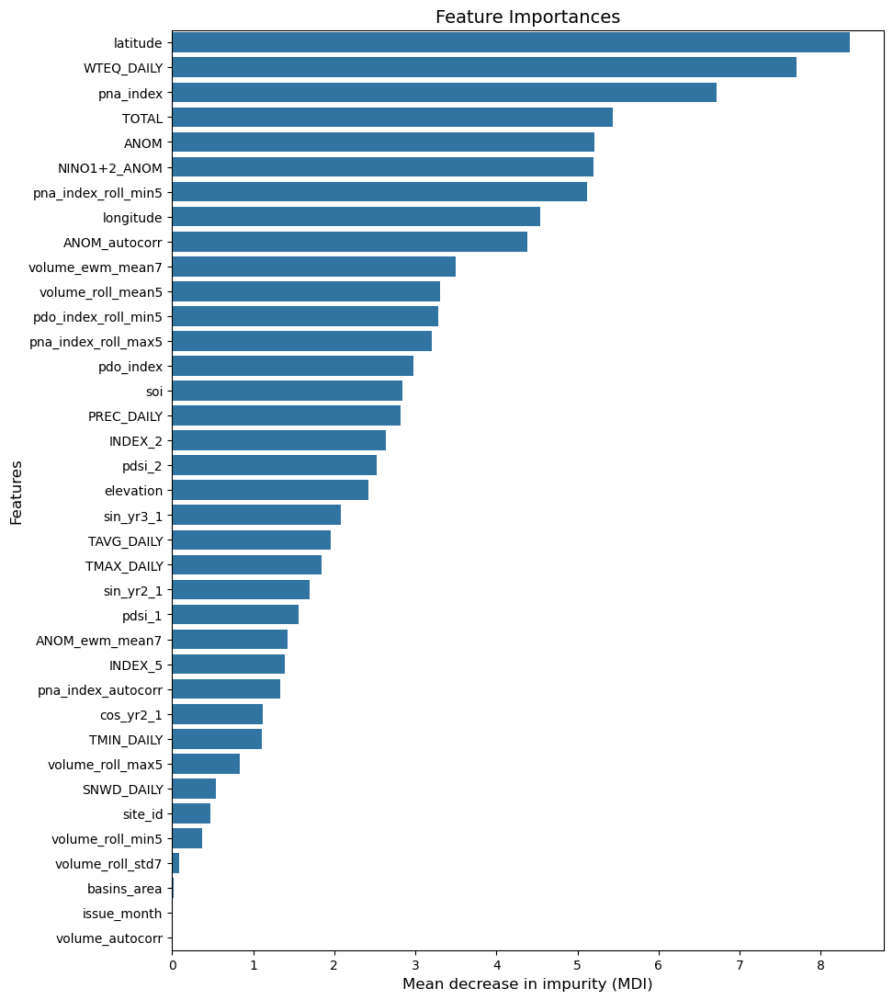

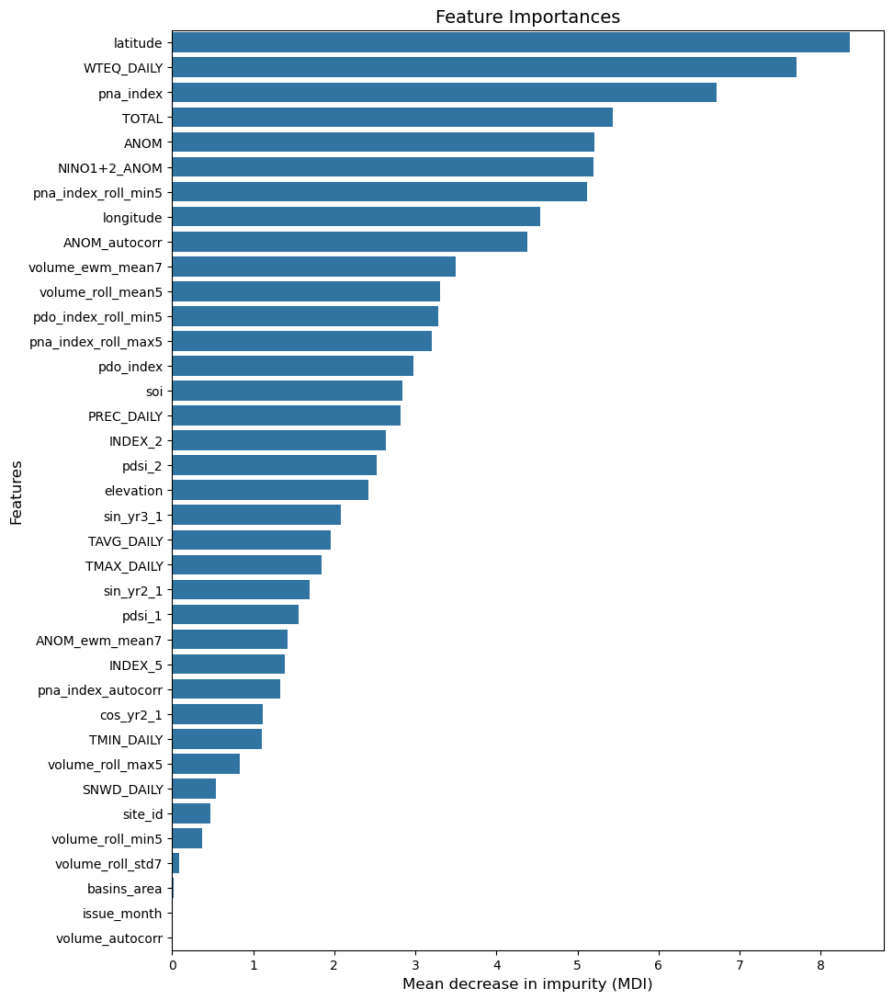

In [449]:
from core.models.utils import plot_feature_importance

features = X.columns
importance = catboost_model.get_feature_importance()
plot_feature_importance(features, importance)

In [201]:
import shap

# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)

X_val_, y_val_, weight_val_ = data_processor.preprocess_transform(
    X_val, y_val, weight_val, mode="val"
)

explainer = shap.Explainer(catboost_model)
shap_values = explainer(X_val_)

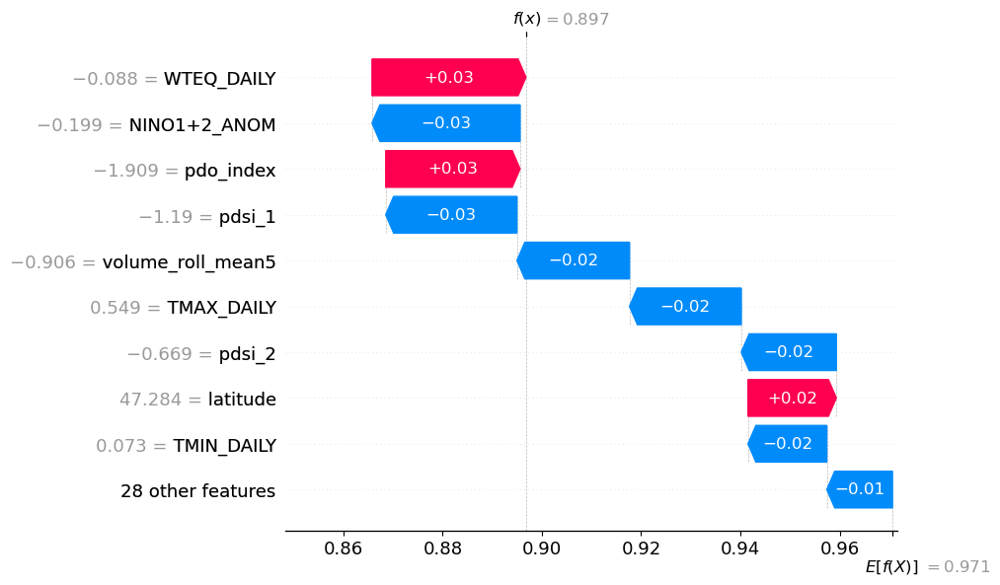

In [203]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[99])

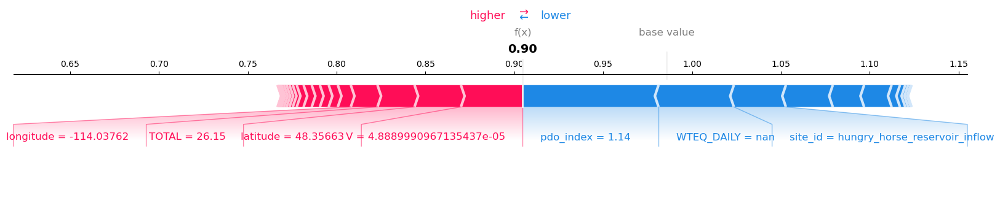

In [151]:
# shap.initjs()
shap.plots.force(shap_values[0], matplotlib=True)

In [48]:
shap.plots.force(shap_values, matplotlib=True)

NotImplementedError: matplotlib = True is not yet supported for force plots with multiple samples!

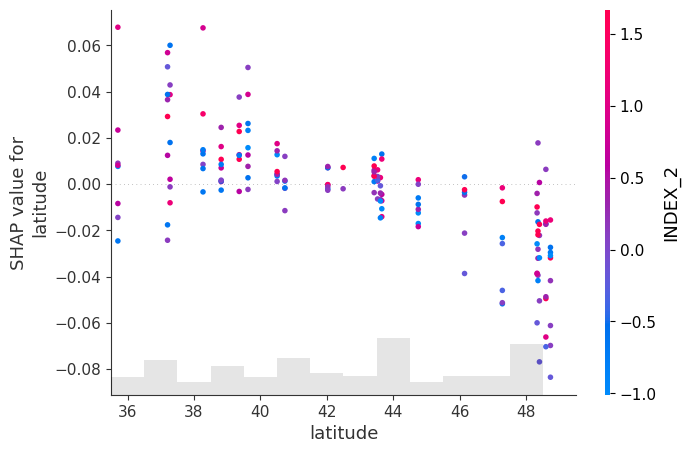

In [49]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.plots.scatter(shap_values[:, "latitude"], color=shap_values)

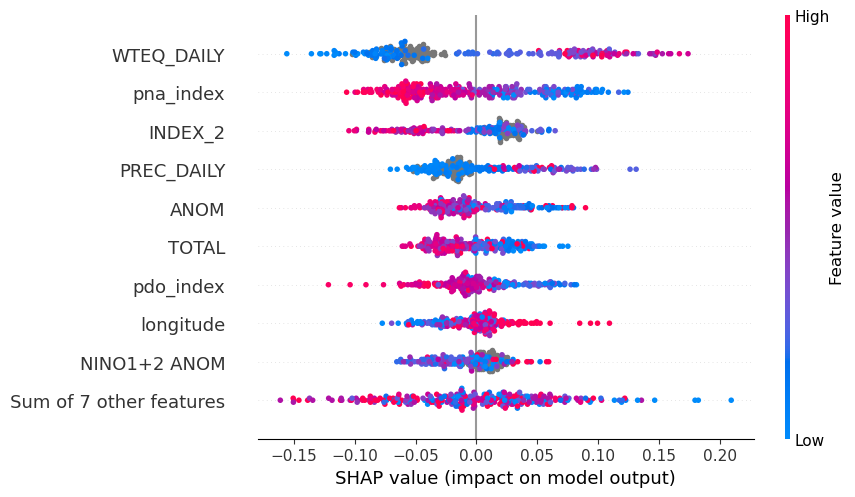

In [50]:
# summarize the effects of all the features
shap.plots.beeswarm(shap_values)

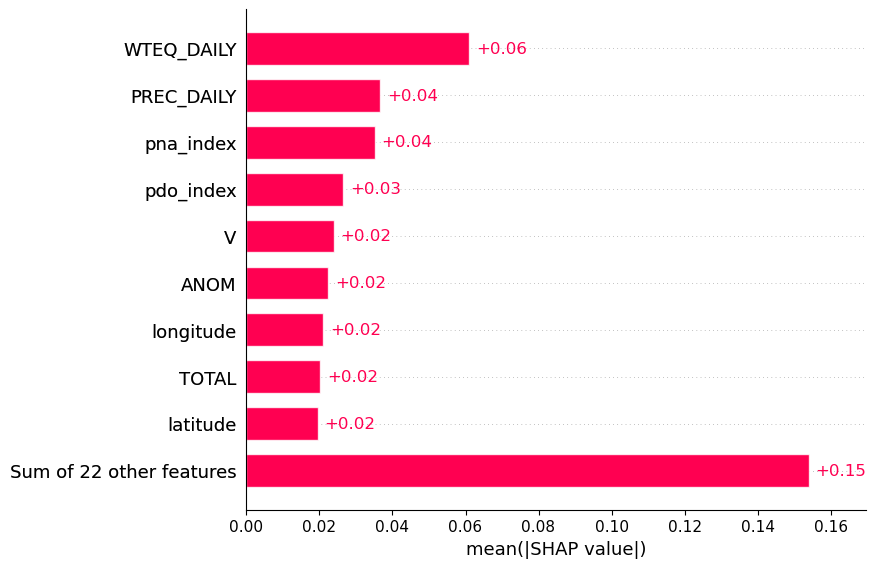

In [154]:
shap.plots.bar(shap_values)

In [155]:
catboost_model.base_models

AttributeError: 'CatBoostRegressor' object has no attribute 'base_models'

In [158]:
# shap.TreeExplainer(catboost_model).shap_interaction_values(X)

In [665]:
import cdsapi

c = cdsapi.Client(
    url="https://cds.climate.copernicus.eu/api/v2",
    key="275276:19c84c47-6d85-49ef-9fdd-34b9268e9d6e",
)
# Define your data request parameters
request_params = {
    "product_type": "monthly_mean",  # Change this as needed
    "format": "grib",  # Data format (e.g., 'grib', 'netcdf')
    "variable": "2m_temperature",  # Change this to the variable you want
    "year": "2020",  # Specify the year
    "month": ["01", "02", "03"],  # Specify months
    "day": ["01", "15", "31"],  # Specify days
    "time": "12:00",  # Specify time (for subdaily data)
    "leadtime_hour": ["24", "48", "72"],  # Lead time hours
}

# Download the data
c.retrieve(
    "seasonal-original-single-levels",  # This is the dataset identifier
    request_params,
    "downloaded_data.grib",  # Output filename
)

2023-12-16 00:31:06,785 INFO Welcome to the CDS
2023-12-16 00:31:06,786 INFO Sending request to https://cds.climate.copernicus.eu/api/v2/resources/seasonal-original-single-levels
2023-12-16 00:31:07,002 INFO Request is queued
2023-12-16 00:31:08,185 INFO Request is running
2023-12-16 00:31:57,718 INFO Request is failed
2023-12-16 00:31:57,732 ERROR Message: Killed by system admin due to internal issue
2023-12-16 00:31:57,733 ERROR Reason:  Killed by system admin due to internal issue


Exception: Killed by system admin due to internal issue. Killed by system admin due to internal issue.

# NN Explainer

In [314]:
explainer2 = shap.Explainer(infernce_engine.model)


h5py is running against HDF5 1.14.3 when it was built against 1.14.2, this may cause problems


ValueError: masker cannot be None.

In [310]:
import sklearn
import shap
from sklearn.model_selection import train_test_split

# print the JS visualization code to the notebook
shap.initjs()

# use Kernel SHAP to explain test set predictions
predict = lambda x: logs["inference_model"][-1].predict(x.reset_index(drop=True))[1]
explainer = shap.KernelExplainer(predict, X_train.sample(1000), link="identity", keep_index=True)
shap_values = explainer.shap_values(X_test.sample(25), nsamples=100)

Using 1000 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/25 [00:00<?, ?it/s]

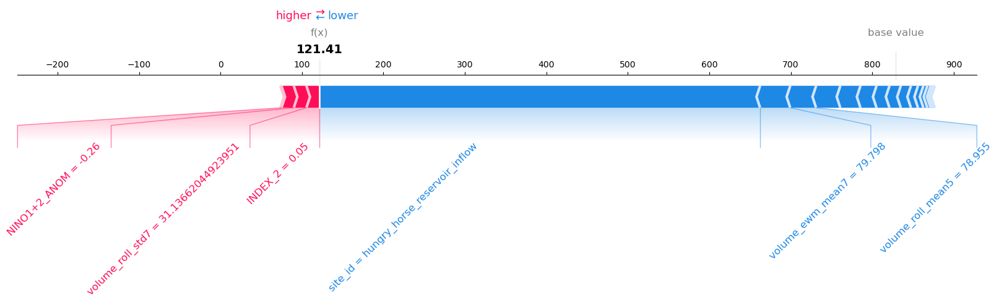

In [313]:
# plot the SHAP values for the Setosa output of the first instance
index = 2
shap.force_plot(
    explainer.expected_value,
    shap_values[index, :],
    X_test.iloc[index, :],
    link="identity",
    matplotlib=True,
    text_rotation=45
)

# Feature Selection

In [163]:
from catboost import CatBoostRegressor, Pool, EShapCalcType, EFeaturesSelectionAlgorithm
from sklearn.datasets import make_regression
from sklearn.model_selection import train_test_split

# X, y = make_regression(n_samples=1000, n_features=100, n_informative=20, random_state=0)
# train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.25, random_state=0)
# feature_names = ['F{}'.format(i) for i in range(train_X.shape[1])]
# train_pool = Pool(train_X, train_y, feature_names=feature_names)
# test_pool = Pool(test_X, test_y, feature_names=feature_names)


data_processor = DataProcessor(
    normalization_configuration={
        "__target__": "md",
        # **{c: "md" for c in X_train.columns if c.startswith("volume")},
        **{
            c: "std"
            for c in X_train.columns
            if (
                c
                not in [
                    "site_id",
                    "issue_month",
                    "latitude",
                    "longitude",
                    "elevation",
                    "basins_area",
                ]
            )
            # and (not c.startswith("volume"))
        },
    }
)
data_processor.preprocess_fit(X_train, y_train)
X_train_, y_train_, weight_train_ = data_processor.preprocess_transform(
    X_train, y_train, weight_train, mode="train"
)
X_val_, y_val_, weight_val_ = data_processor.preprocess_transform(
    X_val, y_val, weight_val, mode="val"
)

train_pool = cb.Pool(
    X_train_, y_train_, weight=weight_train_, cat_features=["site_id", "issue_month"]
)
val_pool = cb.Pool(X_val_, y_val_, weight=weight_val_, cat_features=["site_id", "issue_month"])

model = CatBoostRegressor(
    **{k: v for k, v in default_model_params.items() if k != "feature_weights"}
)
summary = model.select_features(
    train_pool,
    eval_set=val_pool,
    features_for_select=X_train.columns,
    num_features_to_select=15,
    steps=20,
    algorithm=EFeaturesSelectionAlgorithm.RecursiveByShapValues,
    shap_calc_type=EShapCalcType.Regular,
    train_final_model=True,
    logging_level="Silent",
    plot=True,
)

summary["eliminated_features_names"]

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

['pdo_index_autocorr',
 'pna_index_roll_mean5',
 'pna_index_ewm_mean7',
 'NINO1+2_ANOM',
 'pna_index_roll_max5',
 'TMAX_DAILY',
 'ANOM_autocorr',
 'SNWD_DAILY',
 'INDEX_2',
 'soi_ewm_mean7',
 'ANOM_roll_std7',
 'ANOM',
 'TAVG_DAILY',
 'soi_roll_max5',
 'TMIN_DAILY',
 'pna_index_roll_std7',
 'ANOM_roll_min5',
 'soi',
 'latitude',
 'soi_roll_std7',
 'pdo_index_roll_max5',
 'soi_autocorr',
 'pdo_index_roll_std7',
 'elevation_station',
 'soi_roll_mean5',
 'soi_roll_min5',
 'ANOM_roll_max5',
 'cos_yr3_1',
 'ANOM_ewm_mean7',
 'ANOM_roll_mean5',
 'pdo_index_roll_mean5',
 'pdsi_1',
 'site_id',
 'pdo_index',
 'pdo_index_ewm_mean7',
 'elevation',
 'NINO4',
 'longitude',
 'pna_index',
 'pdsi_2',
 'pdo_index_roll_min5',
 'INDEX_5',
 'issue_month']

# Pile

In [156]:
"""
Experiments
1: MVP CV-5 train/val loss: 210 - 249
2: MVP + site metadata: 204 - 234
3: Removing volume scale from #2: 329 - 351
4: Depth + LR tuning: didn't improve

"""

"\nExperiments\n1: MVP CV-5 train/val loss: 210 - 249\n2: MVP + site metadata: 204 - 234\n3: Removing volume scale from #2: 329 - 351\n4: Depth + LR tuning: didn't improve\n\n"

In [ ]:
from core.data.geometry import meters_to_pixels, add_circles_vectorized
from pyproj import Transformer

def generate_2d_features(
    df: pd.DataFrame, transformer, image_size, coverage_radius, circle_radius=5, **kwargs
):
    df["x_station"], df["y_station"] = transformer.transform(
        df["longitude_station"].values, df["latitude_station"].values
    )
    df["x_site"], df["y_site"] = transformer.transform(
        df["longitude_site"].values, df["latitude_site"].values
    )

    pixel_coords = meters_to_pixels(
        meter_coords=df[["x_station", "y_station"]].values,
        center_coords=df[["x_site", "y_site"]].values,
        coverage_area=coverage_radius,
        image_size=image_size,
    )

    padding = circle_radius + 1
    mask = (
        (-padding <= pixel_coords[:, 0])
        & (pixel_coords[:, 0] < image_size[0] + padding)
        & (-padding <= pixel_coords[:, 1])
        & (pixel_coords[:, 1] < image_size[1] + padding)
    )

    features_cols = [
        "PREC_DAILY",
        "SNWD_DAILY",
        "TAVG_DAILY",
        "TMAX_DAILY",
        "TMIN_DAILY",
        "WTEQ_DAILY",
    ]
    image = np.zeros((*image_size, len(features_cols)), dtype=np.float32)

    if mask.sum() == 0:
        return image

    image = add_circles_vectorized(
        image=image,
        coords=pixel_coords[mask],
        values=df[mask][features_cols].values,
        radius=circle_radius,
        **kwargs
    )
    return image
    

In [ ]:
coord_transformer = Transformer.from_proj("EPSG:4326", "ESRI:102004", always_xy=True)  # EPSG:5070

In [ ]:
# result = snotel_sampels.groupby("site_id").apply(
#     lambda df: generate_2d_features(
#         df,
#         image_size=(500, 500),
#         coverage_radius=[100 * 1000, 100 * 1000],
#         transformer=coord_transformer
#     )
# )

In [ ]:
# plt.imshow(result.loc["ruedi_reservoir_inflow"][..., -1])

In [ ]:
import xarray as xr
dem_data = xr.open_dataarray(DATA_ROOT / "cdem" / "processed.nc")
dem_data

<xarray.DataArray 'dem' (y: 23409, x: 22573)>
[528411357 values with dtype=float32]
Coordinates:
  * x            (x) float64 -2.825e+06 -2.825e+06 ... -3.573e+05 -3.572e+05
  * y            (y) float64 1.687e+06 1.687e+06 ... -8.722e+05 -8.723e+05
    spatial_ref  int64 ...
Attributes:
    AREA_OR_POINT:  Point

In [ ]:
import os
import richdem as rd
import scipy.ndimage as ndi
from core.data.geometry import center2bbox

def generate_dem_features(dem : rd.rdarray):
    dem_eps_filled = rd.FillDepressions(dem, epsilon=True)
    accum_d8 = rd.FlowAccumulation(dem_eps_filled, method="Dinf") # np.percentile clipping?
    dem_breached = rd.BreachDepressions(dem, in_place=False) - dem
    slope = rd.TerrainAttribute(dem, attrib='slope_degrees') 
    aspect = rd.TerrainAttribute(dem, attrib='aspect')
    curv_prof = rd.TerrainAttribute(dem, attrib='profile_curvature')
    curv_plan = rd.TerrainAttribute(dem, attrib='planform_curvature')
    curv = rd.TerrainAttribute(dem, attrib='curvature')
    return np.stack((dem_eps_filled, accum_d8, dem_breached, slope, aspect, curv_prof, curv_plan, curv), axis=-1)

site_meter_coordindates = np.stack(
    coord_transformer.transform(metadata["longitude"].values, metadata["latitude"].values), axis=1
)

coverage_meters = 100 * 1000
image_side = 500
zoom_out = 0.15

radius_meters = coverage_meters / 2 * (1 + zoom_out)
# site_dem_features = {}
os.makedirs(DATA_ROOT / "cdem" / "features", exist_ok=True)

for (x, y), site_id in tqdm(zip(site_meter_coordindates, metadata["site_id"]), total=len(metadata)):
    save_path = DATA_ROOT / "cdem" / "features" / f"{site_id}.npz"
    if os.path.isfile(save_path):
        continue
    
    try:
        site_bbox = center2bbox(x, y, radius_meters)
        site_dem = dem_data.sel(
            x=slice(site_bbox[0], site_bbox[2]), y=slice(site_bbox[3], site_bbox[1])
        )
        site_dem = rd.rdarray(site_dem, no_data=np.nan)

        site_features = generate_dem_features(site_dem)
        site_features_cropped = site_features[
            int(zoom_out * site_features.shape[0]) : -int(zoom_out * site_features.shape[0]),
            int(zoom_out * site_features.shape[1]) : -int(zoom_out * site_features.shape[1]),
            :,
        ]
        site_features_final = ndi.zoom(
            site_features_cropped,
            zoom=(
                image_side / site_features_cropped.shape[0],
                image_side / site_features_cropped.shape[1],
                1,
            ),
            order=3,
        )
        # site_dem_features[site_id] = site_features_final
        np.savez_compressed(save_path, site_features_final)
    except:
        print(f"Failed for {site_id}")
        continue

  0%|          | 0/618 [00:00<?, ?it/s]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.146352 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 94901

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 193922
p Calculating flow accumulation...
t Wall-time       = 0.0618453 s==

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0517835====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.014343======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132702====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00873025===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.180356 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 62509

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)         ] (39% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 264499
p Calculating flow accumulation...
t Wall-time 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.056763======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.01379======================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132748====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00847071===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144078 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 19417

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 209960
p Calculating flow accumulation...
[=======                                       

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time       = 0.0610344 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.127622======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0293645====================== ] (99% - 0.0s - 1 threads)

A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0547685====================== ] (9

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.156851 s==================== ] (99% - 0.0s - 1 threads)===============================              ] (73% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 64030

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 216496
p Calculati

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0571683====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134613====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136733====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00869183===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149407 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30395

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 208368
p Calculating flow accumulation...
t Wall-time       = 0.0608863 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.138887 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 27470

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)====================================              ] (72% - 0.1s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 241821
p Calc

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.156302 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 56447

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)===== ] (98% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 250555
p Calculating flow accumulation...
t Wall-time    

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0580944====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131007====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130921====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00889979===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.209355 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 46131

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                              ] (10% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 192414
p Calculating flow accumul

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0547646====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134431====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136979====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0110166====================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149995 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 34478

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 271756
p Calculating flow accumulation...
t Wall-time       = 0.0667912 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0576297====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130831====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0138047====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00883875===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.135872 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 114838

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)    ] (37% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 258016
p Calculating flow accumulation...
t Wall-time     

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.151768 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 18270

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 193538
p Calculating flow accumulation...
t Wall-time       = 0.0622539 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.053584======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.012993======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130243====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00870671===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.161336 s==================== ] (99% - 0.0s - 1 threads)] (96% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 28843

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 188347
p Calculating flow accumulation...
t Wall-time       = 0

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0543677====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134573====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0146224====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00869808===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149417 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 21957

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 188333
p Calculating flow accumulation...
t Wall-time       = 0.0680043 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0538185====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128097====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129485====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00877275===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.165768 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 32966

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 242172
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.054957======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0137467====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132187====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865633===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
[===================================               ] (71% - 0.0s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t succeeded in 0.143258 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 35965

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 223663
p Calculating flow accumulation...
t Wall-time       = 0.0618021 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching..

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.136487 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 62848

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[===                                               ] (5% - 0.4s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 309280
p Calculating flow accumulation...
t Wall-time       = 0.0637473 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.129944======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0279731====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.166863 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 36635

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)         ] (39% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 264283
p Calculating flow accumulation...
t Wall-time 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.123795 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 171230

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)        ] (6% - 0.4s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 330351
p Calculating flow accumulation...
t Wall-time  

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0581963====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136299====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0157091====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866525===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.148922 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 53207

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 212986
p Calculating flow accumulation...
t Wall-time       = 0.0624455 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0537938====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0146542====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132157====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865854===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.154847 s==================== ] (99% - 0.0s - 1 threads)% - 0.1s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30341

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 211729
p Calculating flow accumulation...
t Wall-time       = 0.0642

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013524======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132019====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00878825===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.142519 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 50666

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)[2K[===============================                   ] (62% - 0.1s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 277814
p 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
[==============================                    ] (60% - 0.1s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t succeeded in 0.177373 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 29327

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 250289
p Calculating flow accumulation...
t Wall-time       = 0.0630379 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching..

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.168335 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30786

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)============================                     ] (59% - 0.1s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 209397
p Calcu

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.150619 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 27732

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 227660
p Calculating flow accumulation...
t Wall-time       = 0.0632965 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.141763 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 25859

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)               ] (22% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 237468
p Calculating flow accumulation...
t Wall

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0556885====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013103======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133276====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00875392===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.152031 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 39509

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 272218
p Calculating flow accumulation...
t Wall-time       = 0.0635804 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0565925====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132092====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131496====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00863329===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.147984 s==================== ] (99% - 0.0s - 1 threads)           ] (36% - 0.1s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 27618

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 259831
p Calculating flow accumulation...
t Wall-tim

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0543602====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132785====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0160666====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00845042===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.145251 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 38033

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)       ] (6% - 0.4s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 209129
p Calculating flow accumulation...
t Wall-time    

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0569234====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133701====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136435====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00903837===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.130243 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 152790

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 195700
p Calculating flow 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0551572====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128827====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131122====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00877017===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
[==========================================        ] (84% - 0.0s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t succeeded in 0.125524 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 186659

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 329983
p Calculating flow accumulation...
t Wall-time       = 0.0610382 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching.

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.152331 s==================== ] (99% - 0.0s - 1 threads)% - 0.1s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 32322

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 244722
p Calculating flow accumulation...
t Wall-time       = 0.0604

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0540223====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136899====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134833====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00871471===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.152884 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 31028

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 268121
p Calculating flow accumulation...
t Wall-time       = 0.0656905 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.056005======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134682====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134451====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00889104===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.185514 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 19956

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[=====                                             ] (9% - 0.3s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 208516
p Calculating flow accumulation...
t Wall-time       = 0.0641244 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.146745======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.023145======================= ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.16542 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 114511

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 230130
p Calculating flow accumulation...
t Wall-time       = 0.0610332 s============== 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0532803====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130997====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130759====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00867892===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.157312 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30006

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)      ] (67% - 0.1s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 216546
p Calculating flow accumulation...
t Wall-time    

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.158846 s==================== ] (99% - 0.0s - 1 threads)eads)
m Cells processed = 1106704
m Cells in pits = 35387

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 297383
p Calculating flow accumulation...
t Wall-time       = 0.0638107 s===========

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144171 s==================== ] (99% - 0.0s - 1 threads)===========  ] (97% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 34379

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 210150
p Calculating flow accumulation...
t Wall-t

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0531659====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.01341======================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.014815======================= ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865808===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.138872 s==================== ] (99% - 0.0s - 1 threads)eads)
m Cells processed = 1106704
m Cells in pits = 94455

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 232769
p Calculating flow accumulation...
t Wall-time       = 0.0608103 s===========

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0522527====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134739====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134399====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00863583===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.154489 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 24085

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[===========================================       ] (87% - 0.0s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 214938
p Calculating flow accumulation...
t Wall-time       = 0.0634462 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.130276======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0261381====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.157978 s==================== ] (99% - 0.0s - 1 threads)===============================              ] (73% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 62451

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 244808
p Calculati

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0553861====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136107====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134481====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00888771===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.165396 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 28426

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 243169
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0547281====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128593====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0137725====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865012===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.146485 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 63603

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)       ] (6% - 0.4s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 233121
p Calculating flow accumulation...
t Wall-time    

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0540866====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.01278======================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0237953====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128184====================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.147156 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 18287

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 218803
p Calculating flow accumulation...
t Wall-time       = 0.0617264 s==

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0539798====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129778====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134741====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00867479===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.174968 s==================== ] (99% - 0.0s - 1 threads)threads)
m Cells processed = 1106704
m Cells in pits = 31371

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 220398
p Calculating flow accumulation...
t Wall-time       = 0.060546 s=========

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.151066 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 13762

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)ds)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 194595
p Calculating flow accumulation...
t Wall-time       = 0.0608154 s=============

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.152856 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 18447

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 193113
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0529744====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0127494====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130716====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00863967===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.143586 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 37729

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads) threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 219861
p Calculating flow accumulation...
t Wall-time       = 0.0606893 s=======

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0552252====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134396====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131838====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00864075===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144832 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 36018

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                               ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 255039
p Calculating flow accumu

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0547934====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013396======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136295====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00871121===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.174794 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 58493

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 238899
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0541643====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130095====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133116====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00860692===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.124444 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 174648

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)ds)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 194005
p Calculating flow accumulation...
t Wall-time       = 0.0567317 s============

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0496826====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132895====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128883====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865079===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.138494 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 19842

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)eads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 246362
p Calculating flow accumulation...
t Wall-time       = 0.061662 s============

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0562439====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136017====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.014075======================= ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00867029===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.158036 s==================== ] (99% - 0.0s - 1 threads)=====================        ] (85% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 17614

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 206409
p Calculating flow accumula

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0537703====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0143382====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131023====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00837212===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.147134 s==================== ] (99% - 0.0s - 1 threads)=====                ] (69% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 20180

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 204071
p Calculating flow accumulation...


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0539364====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130593====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131893====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865675===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.195607 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 12644

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 210935
p Calculating flow accumulation...
[====                                          

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time       = 0.0608182 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.140873======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0232781====================== ] (99% - 0.0s - 1 threads)

A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0554746====================== ] (9

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.148879 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 15107

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                      ] (55% - 0.1s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 204885
p Calculating flow accumulation...

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.145849 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 34594

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 237288
p Calculating flow accumulation...
t Wall-time       = 0.0613735 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0550095====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132276====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129424====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0088545====================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.13812 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1104601
m Cells in pits = 30825

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[===========                                       ] (21% - 0.3s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 210323
p Calculating flow accumulation...
t Wall-time       = 0.0607691 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.127444======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0290933====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.142688 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 45873

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 263218
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0558699====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0137153====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131319====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866463===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.141675 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 28696

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[==============================                    ] (61% - 0.1s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 242682
p Calculating flow accumulation...
t Wall-time       = 0.0619043 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.134571======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0265575====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144211 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 51526

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 266578
p Calculating flow accumulation...
t Wall-time       = 0.0614488 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0560405====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129883====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0147153====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00867787===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.14807 s===================== ] (99% - 0.0s - 1 threads)                         ] (20% - 0.1s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 48469

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 221965
p Calculating flow accumulation

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0146666====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133093====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00873108===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144787 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 22422

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 243650
p Calculating flow accumulation...
t Wall-time       = 0.0621221 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0562195====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132675====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132001====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00884275===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.1852 s====================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 19302

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads) (34% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 219341
p Calculating flow accumulation...
t Wall-time       = 0.

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0543156====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129692====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131958====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00872596===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.158952 s==================== ] (99% - 0.0s - 1 threads)=========                      ] (57% - 0.1s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 25943

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 217758
p Calculating flow accumu

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0543316====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0149168====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131488====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00864817===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.15153 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 27371

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads) threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 216453
p Calculating flow accumulation...
t Wall-time       = 0.0621873 s=======

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0550679====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0142983====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132275====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0086515====================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.150548 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 15607

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                              ] (10% - 0.4s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 210642
p Calculating flow accumul

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.0538031====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130804====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013925======================= ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00870467===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.154936 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 122275

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)    ] (37% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 228472
p Calculating flow accumulation...
t Wall-time     

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0529396====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0135873====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132181====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00871958===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.155413 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 44763

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                              ] (10% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 267022
p Calculating flow accumul

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.153334 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 32482

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                ] (23% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 194010
p Calculating flow accum

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.054032======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128775====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0138052====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00868479===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.136479 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 126845

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 228725
p Calculating flow accumulation...
t Wall-time       = 0.059284 s=============== 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.053568======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130966====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129361====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00885183===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.143828 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30032

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[=============================                     ] (58% - 0.1s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 268313
p Calculating flow accumulation...
t Wall-time       = 0.0620283 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.13533======================== ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.025661======================= ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.135158 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 30536

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 206141
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0542594====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130287====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131499====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866421===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149973 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 16419

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads) - 0.4s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 225072
p Calculating flow accumulation...
t Wall-time       = 0.06080

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128215====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130093====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865433===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.147266 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 40466

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 208235
p Calculating flow accumulation...
[===========================                   

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time       = 0.0607861 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.140324======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0240935====================== ] (99% - 0.0s - 1 threads)

A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0547697====================== ] (9

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144507 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 60328

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[=============================================     ] (91% - 0.0s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 178768
p Calculating flow accumulation...
t Wall-time       = 0.0616431 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.149293======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0228477====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.154207 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 25704

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 246624
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0553956====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130395====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0130873====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866133===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 1.75e-06 s
m Cells processed = 0
m Cells in pits = 0

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.


A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 0
p Calculating flow accumulation...
t Wall-time       = 1.5208e-05 s

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital el

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 246490
p Calculating flow accumulation...
t Wall-time       = 0.0649666 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.137579======================= ] (98% - 0.0s - 1 t

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0555705====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134994====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131992====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866313===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149642 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 40102

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                    ] (25% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 245304
p Calculating flow accumulation...
t

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.148086 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 19760

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 215004
p Calculating flow accumulation...
t Wall-time       = 0.06076 s================ ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.152872 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 47822

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[===========                                       ] (21% - 0.3s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 201597
p Calculating flow accumulation...
t Wall-time       = 0.0617966 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.146193======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0236927====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.144659 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 26500

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 213237
p Calculating flow accumulation...
t Wall-time       = 0.0633977 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0553995====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013223======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134701====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0088845====================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.149617 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 33482

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)====                                             ] (11% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 246558
p Calcu

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)


t Wall-time = 0.0537062====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0129856====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0127972====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00869613===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.146437 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 28265

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[==                                                ] (4% - 0.4s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 260155
p Calculating flow accumulation...
t Wall-time       = 0.0621633 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.144084======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0227866====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.14495 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 47222

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 280078
p Calculating flow a

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.055273======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0137446====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132953====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00864708===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.140404 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 30098

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                    ] (25% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 220901
p Calculating flow accumulation...
t

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.136777 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 102483

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 223997
p Calculating flow accumulation...
t Wall-time       = 0.0596884 s============== 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0143319====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134808====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865613===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.158676 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 40430

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                    ] (25% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 263020
p Calculating flow accumulation...
t

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0557813====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131007====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131733====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00865058===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.17083 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 26578

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[==================                                ] (36% - 0.2s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 272999
p Calculating flow accumulation...
t Wall-time       = 0.0619585 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.136934======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0230516====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.138715 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1105652
m Cells in pits = 22705

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)    ] (37% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 233499
p Calculating flow accumulation...
t Wall-time      

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.175161 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 111114

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 239244
p Calculating flow 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013014======================= ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.013294======================= ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00871417===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.1406 s====================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 113548

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)                                    ] (13% - 0.3s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 230388
p Calculating flow 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0528848====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0134837====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0131258====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00869546===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.14969 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 62912

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads) 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 242276
p Calculating flow accumulation...
t Wall-time       = 0.0614422 s=====

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.142502 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 96733

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[==================                                ] (36% - 0.2s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 248721
p Calculating flow accumulation...
t Wall-time       = 0.0638388 s============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.147303======================= ] (99% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0241225====================== ] (99% - 0.0s - 1 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.159643 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 40390

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 230661
p Calculating flow accumulation...
t Wall-time       = 0.061793 s=============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0545454====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133971====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132307====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00866862===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.165428 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 20032

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 205337
p Calculating flow accumulation...
t Wall-time       = 0.0608078 s============== ]

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

t Wall-time = 0.054379======================= ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0128865====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0133765====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00868179===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.16561 s===================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1104601
m Cells in pits = 71946

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[================================================= ] (99% - 0.0s - 1 threads)2K[===============                                   ] (31% - 0.2s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 283363
p C

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 


A Aspect attribute calculation
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0573118====================== ] (99% - 0.0s - 1 threads)

A Profile curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0136641====================== ] (99% - 0.0s - 1 threads)

A Planform curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.0132304====================== ] (99% - 0.0s - 1 threads)

A Curvature attribute calculation
C Zevenbergen, L.W., Thorne, C.R., 1987. Quantitative analysis of land surface topography. Earth surface processes and landforms 12, 47–56.

t Wall-time = 0.00892679===================== ] (99% - 0.0s - 1 threads)


Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.161176 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 1106704
m Cells in pits = 58056

A Tarboton (1997) Flow Accumulation (aka D-Infinity, D∞)
C Tarboton, D.G., 1997. A new method for the determination of flow directions and upslope areas in grid digital elevation models. Water resources research 33, 309–319.

[=============================                     ] (58% - 0.1s - 1 threads)

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top 

[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 247039
p Calculating flow accumulation...
t Wall-time       = 0.064203 s=============== ] (99% - 0.0s - 1 threads)

A Lindsay2016: Breach Depressions
C Lindsay, J.B., 2016. Efficient hybrid breaching-filling sink removal methods for flow path enforcement in digital elevation models: Efficient Hybrid Sink Removal Methods for Flow Path Enforcement. Hydrological Processes 30, 846--857. doi:10.1002/hyp.10648

c topology = D8
p Identifying pits and edge cells...
p Breaching...=============================== ] (99% - 0.0s - 1 threads)
t Wall-time = 0.158646======================= ] (98% - 0.0s - 1 threads)

A Slope calculation (degrees)
C Horn, B.K.P., 1981. Hill shading and the reflectance map. Proceedings of the IEEE 69, 14–47. doi:10.1109/PROC.1981.11918

t Wall-time = 0.0257849====================== ] (99% - 0.0s - 1 

: 

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.105784 s==================== ] (99% - 0.0s - 1 threads)
m Cells processed = 837225
m Cells in pits = 24709


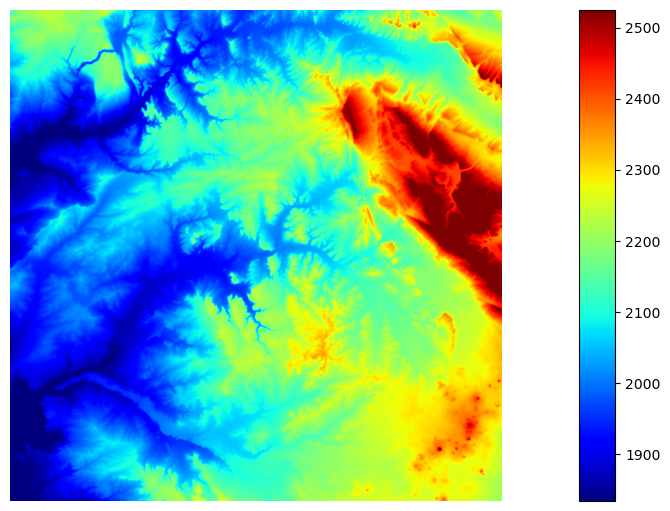

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A O'Callaghan (1984)/Marks (1984) D8/D4 Flow Accumulation
C O'Callaghan, J.F., Mark, D.M., 1984. The Extraction of Drainage Networks from Digital Elevation Data. Computer vision, graphics, and image processing 28, 323--344.

c topology = D8
[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 279914
p Calculating flow accumulation...
t Wall-time       = 0.0365516 s============== ] (99% - 0.0s - 1 threads)
/Users/nsarang/anaconda3/envs/watersupply/lib/python3.10/site-packages/richdem/__init__.py:107: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


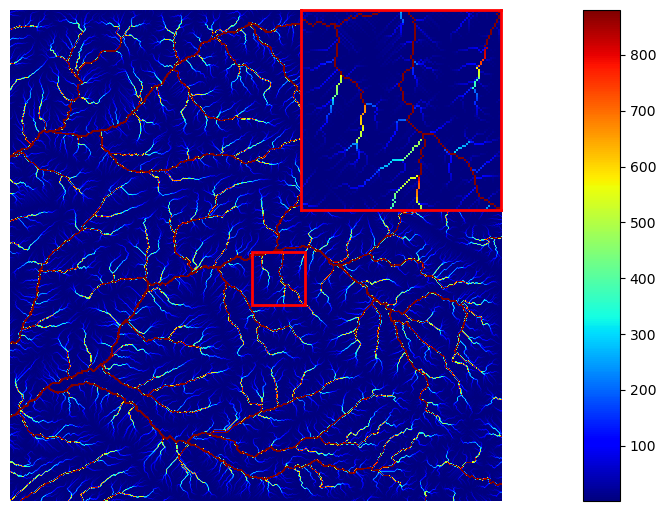

In [ ]:
import pystac_client
import planetary_computer
import rioxarray
import richdem as rd
import matplotlib.pyplot as plt
# Assuming 'data' is your xarray DataArray
bounds = site_dem.rio.bounds()
extent = [bounds[0], bounds[2], bounds[1], bounds[3]]  # Format: [min_x, max_x, min_y, max_y]

# Convert the xarray DataArray to a numpy array
dem_np = site_dem.values

# Handle no data values if necessary
# dem_np[site_dem.isnull()] = -9999  # or an appropriate no-data value

# Convert the numpy array to a richdem DEM object
dem_rd = rd.rdarray(dem_np, no_data=np.nan)

# Fill depressions in DEM
dem_filled = rd.FillDepressions(dem_rd, epsilon=True)
rd.rdShow(dem_filled, ignore_colours=[0], axes=False, cmap="jet", figsize=(8, 5.5))

accum_d8 = rd.FlowAccumulation(dem_filled, method="D8")
d8_fig = rd.rdShow(
    accum_d8, zxmin=450, zxmax=550, zymin=550, zymax=450, figsize=(8, 5.5), axes=False, cmap="jet"
)

In [ ]:
# data_processor = DataProcessor(
#     normalization_configuration={
#         "__target__": "md",
#         **{c: "md" for c in X_train.columns if c.startswith("volume_roll_mean5")},
#         **{
#             c: "std"
#             for c in X_train.columns
#             if (
#                 c
#                 not in [
#                     "site_id",
#                     "issue_month",
#                     "latitude",
#                     "longitude",
#                     "elevation",
#                     "basins_area",
#                 ]
#             )
#             and (not c.startswith("volume_roll_mean5"))
#         },
#     }
# )
# data_processor.preprocess_fit(X_train, y_train)
# X_train, y_train, weight_train = data_processor.preprocess_transform(
#     X_train, y_train, weight_train, mode="train"
# )
# X_val, y_val, weight_val = data_processor.preprocess_transform(
#     X_val, y_val, weight_val, mode="val"
# )

# models = [
#     cb.CatBoostRegressor(**default_model_params, loss_function="MAE", random_seed=100),
#     # cb.CatBoostRegressor(**default_model_params, loss_function=RmseQuantilieObjective(quantile=0.5), eval_metric=RmseQuantilieMetric(quantile=0.5)),
#     # cb.CatBoostRegressor(**default_model_params, loss_function="Quantile:alpha=0.1"),
#     # cb.CatBoostRegressor(**default_model_params, loss_function="Quantile:alpha=0.9"),
# ]

# train_pool = cb.Pool(X_train, y_train, weight=weight_train, cat_features=["site_id", "issue_month"])
# val_pool = cb.Pool(X_val, y_val, weight=weight_val, cat_features=["site_id", "issue_month"])

# for m in models:
#     m.fit(train_pool, eval_set=[train_pool, val_pool], early_stopping_rounds=100)

# y_train_pred = np.array([m.predict(X_train) for m in models])
# y_val_pred = np.array([m.predict(X_val) for m in models])

# y_train_pred = data_processor.postprocess_transform(X_train, y_train_pred)
# y_val_pred = data_processor.postprocess_transform(X_val, y_val_pred)

# model, data_processor, _, _ = train_catboost(
#     X_train, y_train, X_val, y_val, weight_train, weight_val, **aggressive_model_params
# )

In [ ]:
# from tqdm.auto import tqdm

# tqdm.pandas()


# volume_feats = dataset.progress_apply(
#     generate_timeseries_features,
#     df_b=df_monthly,
#     condition=(
#         "site_id == @row.site_id"
#         " & forecast_year == @row.forecast_year"
#         " & ~(date.dt.year == @row.issue_date.year & date.dt.month >= @row.issue_date.month)"
#         # " & ((date.dt.year == (@row.issue_date.year - 1) & date.dt.month >= 10)"
#         # "    | (date.dt.year == @row.issue_date.year & date.dt.month < @row.issue_date.month))"
#     ),
#     date_col="date",
#     feature_engineering=["volume"],
#     axis=1,
# )

# assert len(volume_feats) == len(dataset)
# dataset = pd.concat(add_column_suffix(dataset, volume_feats, suffixes=("", "_vol")), axis=1)

# for name, df_dataset in teleconn_data.items():
#     print(name)
#     df_feats = dataset.progress_apply(
#         generate_timeseries_features,
#         df_b=df_dataset,
#         condition=(
#             "date.dt.year < @row.issue_date.year"
#             " | (date.dt.year == @row.issue_date.year & date.dt.month < @row.issue_date.month)"
#         ),
#         date_col="date",
#         feature_engineering=feature_engineering.get(name, []),
#         axis=1,
#     )
#     dataset = pd.concat(
#         add_column_suffix(dataset, df_feats, suffixes=("", "_" + name.lower())), axis=1
#     )

In [ ]:
# import dask_expr as dx
# from dask.diagnostics import ProgressBar
# pbar = ProgressBar()
# pbar.register()


# dx_dataset = dx.from_pandas(dataset[["site_id", "issue_date", "forecast_year"]])

# volume_features = (
#     dx_dataset
#     .merge(dx.from_pandas(df_monthly), on=["site_id", "forecast_year"], suffixes=("", "_m"))
#     .query("~(date.dt.year == issue_date.dt.year & date.dt.month >= issue_date.dt.month)")
#     .groupby(["site_id", "issue_date"])
#     .apply(generate_timeseries_features_v2, date_col="date", features=["volume"])
#     .compute()
# )

# from core.data.utils import _dx_cross_merge

# teleconn_features = {}
# feature_engineering = {
#     # "MJO": ["INDEX_2", "INDEX_5"], # ...
#     "PDO": ["pdo_index"],
#     # "NINO": ["NINO3.4 ANOM", "NINO3 ANOM", "NINO4"], # ...
#     "ONI": ["ANOM"],  # TOTAL
#     "PNA": ["pna_index"],
#     "SOI": ["soi"],
# }

# feature_suffixes = [
#     "_roll_std7",
#     "_roll_mean5",
#     "_ewm_mean7",
#     "_autocorr",
#     "_roll_max5",
#     "_roll_min5",
#     "_count_7"
# ]

# for name, df_teleconn in teleconn_data.items():
#     print(name)
#     dx_features = (
#         _dx_cross_merge(dx_dataset, df_teleconn, suffixes=("", "_m"))
#         .query(
#             "(date.dt.year < issue_date.dt.year & date.dt.year > issue_date.dt.year - 10)"
#             " | (date.dt.year == issue_date.dt.year & date.dt.month < issue_date.dt.month)"
#         )
#         .groupby(["site_id", "issue_date"])
#         .apply(
#             generate_timeseries_features_v2,
#             date_col="date",
#             features=feature_engineering.get(name, []),
#         )
#     )
#     teleconn_features[name] = dx_features

In [ ]:
import math


def haversine(coord1, coord2):
    # Coordinates in decimal degrees (e.g. 2.298, 48.858)
    lon1, lat1 = coord1
    lon2, lat2 = coord2

    R = 6371  # Earth radius in kilometers

    # Convert latitude and longitude from decimal degrees to radians
    phi1 = math.radians(lat1)
    phi2 = math.radians(lat2)
    delta_phi = math.radians(lat2 - lat1)
    delta_lambda = math.radians(lon2 - lon1)

    # Haversine formula
    a = (
        math.sin(delta_phi / 2) ** 2
        + math.cos(phi1) * math.cos(phi2) * math.sin(delta_lambda / 2) ** 2
    )
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = R * c  # in kilometers

    return distance


# Define your coordinates
point1 = [-112.65, 35.55]  # [longitude, latitude]
point2 = [-111.65, 36.55]  # [longitude, latitude]

# Calculate the distance
distance = haversine(point1, point2)
print(f"The distance between the two points is {distance} kilometers.")

In [362]:
df_targets.site_id.unique()

array(['animas_r_at_durango', 'boise_r_nr_boise',
       'boysen_reservoir_inflow', 'colville_r_at_kettle_falls',
       'detroit_lake_inflow', 'dillon_reservoir_inflow',
       'fontenelle_reservoir_inflow', 'green_r_bl_howard_a_hanson_dam',
       'hungry_horse_reservoir_inflow', 'libby_reservoir_inflow',
       'missouri_r_at_toston', 'owyhee_r_bl_owyhee_dam',
       'pecos_r_nr_pecos', 'pueblo_reservoir_inflow',
       'ruedi_reservoir_inflow', 'skagit_ross_reservoir',
       'snake_r_nr_heise', 'stehekin_r_at_stehekin',
       'sweetwater_r_nr_alcova', 'taylor_park_reservoir_inflow',
       'virgin_r_at_virtin', 'weber_r_nr_oakley', 'yampa_r_nr_maybell'],
      dtype=object)

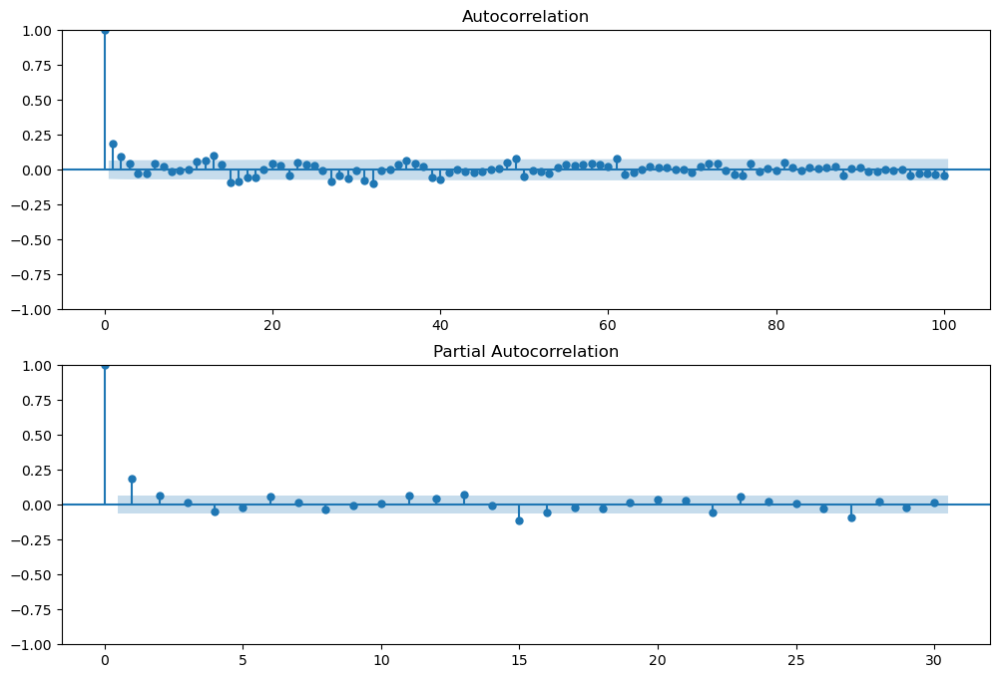

In [458]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

# Visualizations
lag_acf = 5
lag_pacf = 10
height = 4
width = 12

sample = teleconn_data["PNA"]

f, ax = plt.subplots(nrows=2, ncols=1, figsize=(width, 2 * height))
plot_acf(sample["pna_index"].dropna(), lags=100, ax=ax[0])
plot_pacf(sample["pna_index"].dropna(), ax=ax[1], method="ols")

In [227]:
df_oct_dec = df_monthly.groupby(["site_id", "forecast_year"]).apply(
    lambda df: df[df["month"].isin([10, 11, 12])].sort_values("month").set_index("month")["volume"]
)
df_oct_dec = pd.pivot_table(
    df_oct_dec.reset_index(), index=["site_id", "forecast_year"], columns="month"
)
df_oct_dec.columns = df_oct_dec.columns.map(lambda x: "_".join(map(str, x)))
df_oct_dec = df_oct_dec.reset_index()


# .merge(
#     df_oct_dec,
#     on=["site_id", "forecast_year"],
#     how="inner",
# )
# )
# dataset["issue_date"] = dataset["forecast_year"].apply(lambda y: get_issue_date(y))
# dataset

In [ ]:
import plotly.express as px

gg = (
    df_train_monthly.merge(metadata, on="site_id")
    .groupby(["site_id", "forecast_year"])
    .apply(
        lambda df: df[df["month"].between(df["season_start_month"], df["season_end_month"])][
            "volume"
        ].sum()
    )
    .reset_index(name="volume_est")
    .merge(
        df_train_targets.rename(columns={"year": "forecast_year"}), on=["site_id", "forecast_year"]
    )
)


gg["r"] = gg["volume_est"] / gg["volume"]
gg2 = gg.merge(gg.groupby("site_id")["r"].median().reset_index(name="r_med"), on="site_id")
gg2["volume_est_2"] = gg2["volume_est"] / gg2["r_med"]
gg2["r2"] = gg2["volume_est_2"] / gg2["volume"]

px.line(
    df_train_targets.sort_values(["site_id", "year"], ascending=True),
    x="year",
    y=["volume"],
    color="site_id",
)

px.line(
    gg2.sort_values(["site_id", "forecast_year"], ascending=True),
    x="forecast_year",
    y=["r2"],
    color="site_id",
)

metadata

gg2 = gg.merge(
    gg.groupby("site_id").apply(
        lambda gg: (gg["volume_est"] / gg["volume"]).reset_index(name="r")
    ),
    on="site_id",
)
gg2.groupby("site_id")["r"].describe()
gg.groupby("site_id").apply(lambda gg: (gg["volume_est"] / gg["volume"]).median())

In [392]:
import plotly.express as px

px.line(
    dataset.sort_values(["site_id", "year"], ascending=True),
    x="year",
    y=["SNWD_DAILY"],
    color="site_id",
)

In [33]:
import plotly.express as px

px.line(
    dataset.query("issue_date.dt.month == 1")
    # .merge(df_train_targets_v2[["site_id", "forecast_year"]], on=["site_id", "forecast_year"])
    .sort_values(["site_id", "year"], ascending=True),
    x="year",
    y=["volume"],
    color="site_id",
)

In [436]:
import plotly.express as px

px.line(
    df_targets.sort_values(["site_id", "year"], ascending=True),
    x="year",
    y=["volume"],
    color="site_id",
)

In [ ]:
# df_oct_dec = df_train_monthly.groupby(["site_id", "forecast_year"]).apply(
#     lambda df: df[df["month"].isin([10, 11, 12])]
#     .sort_values("month")
#     .set_index("month")["volume"]
# )
# df_oct_dec = pd.pivot_table(
#     df_oct_dec.reset_index(), index=["site_id", "forecast_year"], columns="month"
# )
# df_oct_dec.columns = df_oct_dec.columns.map(lambda x: "_".join(map(str, x)))
# df_oct_dec = df_oct_dec.reset_index()

# dataset = (
#     df_train_targets
#     .rename(columns={"year": "forecast_year"})
#     .dropna() # Cali sites are dropped
#     .merge(ALL_ISSUE_DATES[ALL_ISSUE_DATES.dt.month == 1], left_on="forecast_year", right_on=ALL_ISSUE_DATES[ALL_ISSUE_DATES.dt.month == 1].dt.year)
#     .merge(metadata, on="site_id", suffixes=("", "_md"))
#     .merge(
#         df_oct_dec,
#         on=["site_id", "forecast_year"],
#         how="inner",
#     )
# )
# dataset

In [ ]:
# cb.CatBoostRegressor(**default_model_params, loss_function='Quantile:alpha=0.1'),
# cb.CatBoostRegressor(**default_model_params, loss_function='Quantile:alpha=0.5'),
# cb.CatBoostRegressor(**default_model_params, loss_function='Quantile:alpha=0.9'),

# cb.CatBoostRegressor(**default_model_params, loss_function=RmseQuantilieObjective(quantile=0.1), eval_metric=RmseQuantilieMetric(quantile=0.1)),
# cb.CatBoostRegressor(**default_model_params, loss_function=RmseQuantilieObjective(quantile=0.5), eval_metric=RmseQuantilieMetric(quantile=0.5)),
# cb.CatBoostRegressor(**default_model_params, loss_function=RmseQuantilieObjective(quantile=0.9), eval_metric=RmseQuantilieMetric(quantile=0.9)),

In [54]:
# X[["volume_10", "volume_11", "volume_12"]] = X[["volume_10", "volume_11", "volume_12"]] / X["basins_area"].values[:, None]
# X["V"] = dataset[["volume_10", "volume_11", "volume_12"]].mean(axis=1)  / (X["basins_area"].values ** 2)


# X = X.drop(columns=["volume_10", "volume_11", "volume_12"])
# X = X.reset_index(drop=True).dropna(subset="V").reset_index(drop=True)
# site_codes = site_codes.iloc[X.index].reset_index(drop=True)
# y = y.iloc[X.index].reset_index(drop=True)
# weight = weight[X.index]

# Leftover

In [ ]:
from core.recipes.mvp import cfg as mvp_cfg
from core.train import train_util, train_catboost, Ensemble

dataset_final = dataset_orig[dataset_orig["forecast_year"].isin(df_train_targets["year"])].copy()
dataset_final["yr_in_2yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 2
dataset_final["yr_in_3yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 3
dataset_final["yr_in_4yr_cycle"] = (dataset.issue_date.dt.year - 1800) % 4
dataset_final["issue_month"] = dataset_final["issue_date"].dt.month
dataset_final = dataset_final[dataset_final["issue_month"] == 1]
dataset_final = dataset_final[dataset_final["issue_date"].dt.day == 1]

In [ ]:
# Fourier series components for 4-year seasonality
num_terms = 1  # Number of Fourier terms
for n in range(1, num_terms + 1):
    for cycle in [2, 3, 4]:
        dataset_final[f"sin_yr{cycle}_{n}"] = np.sin(
            2 * np.pi * n * dataset_final[f"yr_in_{cycle}yr_cycle"] / cycle
        )
        dataset_final[f"cos_yr{cycle}_{n}"] = np.cos(
            2 * np.pi * n * dataset_final[f"yr_in_{cycle}yr_cycle"] / cycle
        )
logs_n = train_util(dataset_final, mvp_cfg)


@dataclass
class Ensemble:
    models: List
    data_processors: List[DataProcessor] = None
    weights: List[float] = None
    feature_columns: List[str] = None

    def predict(self, inputs):
        predictions = []
        if self.feature_columns is not None:
            inputs = inputs[self.feature_columns]

        for idx, model in enumerate(self.models):
            if self.data_processors is not None:
                data_prep = self.data_processors[idx]
                features, *_ = data_prep.preprocess_transform(inputs, mode="val")
                logits = model.predict(features)
                prediction = data_prep.postprocess_transform(features, logits, mode="val")
            else:
                prediction = model.predict(inputs)
            predictions += [prediction]

        if self.weights is None:
            weights = [1] * len(self.models)
        else:
            weights = self.weights
        print(len(prediction))
        output = np.average(predictions, axis=0, weights=weights)
        return output

In [ ]:
import pickle

pickle.dump(logs_n["model"], open("model2.pkl", "wb"))
ff = pickle.load(open("model2.pkl", "rb"))

In [ ]:
abc = logs_n["model"].predict(X_test)

3 5
3 5
3 2


In [ ]:
abc2 = ff.predict(X_test)

6 5
6 5
6 2


array([[1317.82790955, 1319.54726547, 1407.87600873, 1483.53584026,
        1532.38520551, 1307.14088339, 1442.91279731, 1196.95261272,
        1495.07234286, 1410.64116283, 1878.08818511, 1937.65669354,
        1977.88942115, 2074.96129115, 2069.07381797, 1898.17312191,
        2095.80489708, 1746.2684702 , 1944.66830447, 1969.02247911,
         150.01234363,  163.93413603,  152.41198215,  155.87571477,
         116.29413191,  147.77639531,  154.90246158,  134.79688731,
         136.01834235,  142.56026611,   36.85108589,   33.19275711,
          35.01832047,   36.38642415,   35.70072533,   34.64713992,
          40.61137808,   31.55980827,   25.29283291,   33.90536587,
        1096.95441664, 1119.33126732, 1242.7138645 , 1365.61337589,
        1246.51220349, 1119.29209303, 1223.98270276, 1079.60701629,
        1214.51838927, 1242.46298296,  260.79270564,  259.11039244,
         227.66332065,  231.46601485,  187.51690375,  220.88222754,
         248.19805726,  210.03103716,  157.78150

In [ ]:
abc2[:3]

array([[1290.87890292, 1312.01827041, 1397.38580482, 1507.32169708,
        1525.0861489 , 1285.2357717 , 1424.25582655, 1164.54884433,
        1484.20277006, 1405.73072816, 1834.88504916, 1926.02400023,
        1958.65654458, 2111.36767962, 2047.84988979, 1885.45034309,
        2076.51352538, 1716.93632924, 1907.82505851, 1968.31411206,
         152.02227924,  170.03426466,  158.19620578,  165.3359159 ,
         126.76489915,  153.24126742,  157.45521927,  141.43908732,
         137.55383701,  150.31962944,   38.75344565,   35.49424955,
          37.21855728,   38.73254726,   37.70594693,   36.54837474,
          41.69987263,   32.9598309 ,   26.57793481,   35.81876163,
        1108.87000186, 1125.5149053 , 1275.9007446 , 1412.95547298,
        1261.90229008, 1126.31389022, 1211.7711824 , 1066.08223045,
        1203.9736053 , 1296.52443353,  266.46226224,  265.37704017,
         232.11581882,  237.5771423 ,  191.8308108 ,  224.72760196,
         250.08684296,  216.10465244,  161.36139

In [ ]:
len(ff.models[1].models)

5

In [ ]:
# from core.train import Ensemble
model2 = Ensemble(
    logs_n["catboost_raw_models"],
    logs_n["catboost_data_processor"],
    # weights=[1] * len(logs["models"]),
    # weights=1 / error_val_folds,
    # feature_columns=logs["models"][0].feature_name_,
    # feature_columns = None
)

X_pred_val2 = model2.predict(X_test[logs_n["catboost_raw_models"][0].feature_names_[0]])

[1, 1, 1, 1, 1] [[<catboost.core.CatBoostRegressor object at 0x2f6df43a0>, <catboost.core.CatBoostRegressor object at 0x2d25ed990>, <catboost.core.CatBoostRegressor object at 0x2d2262ec0>], [<catboost.core.CatBoostRegressor object at 0x2d22c9d20>, <catboost.core.CatBoostRegressor object at 0x2d22c06d0>, <catboost.core.CatBoostRegressor object at 0x2d22bd2a0>], [<catboost.core.CatBoostRegressor object at 0x2d266a320>, <catboost.core.CatBoostRegressor object at 0x2d7ef87c0>, <catboost.core.CatBoostRegressor object at 0x2d2677640>], [<catboost.core.CatBoostRegressor object at 0x2d22bfd00>, <catboost.core.CatBoostRegressor object at 0x2d2663580>, <catboost.core.CatBoostRegressor object at 0x2f7651a20>], [<catboost.core.CatBoostRegressor object at 0x2f766ad40>, <catboost.core.CatBoostRegressor object at 0x2f7623130>, <catboost.core.CatBoostRegressor object at 0x2f76d7dc0>]]


In [ ]:
logs_n["model"].predict(X_test[logs_n["catboost_raw_models"][0].feature_names_[0]]).shape

(3, 230)

In [ ]:
logs_n["model"].models[0].predict(X_test)

CatBoostError: Invalid type for cat_feature[non-default value idx=0,feature_idx=38]=nan : cat_features must be integer or string, real number values and NaN values should be converted to string.

In [ ]:
class Vector2(list):
    def __getattr__(self, key):
        return Vector([getattr(instance, key) for instance in self])

    def __call__(self, *args, **kwargs):
        return [instance(*args, **kwargs) for instance in self]

    def __getstate__(self):
        # Return the state that needs to be pickled
        return self.__dict__.copy(), list(self)

    def __setstate__(self, state):
        # Restore the state from the pickled state
        self.__dict__, list_contents = state
        self.extend(list_contents)

In [ ]:
from copy import deepcopy

gg = deepcopy(logs_n["model"].models[0].models[0])
# gg.models = Vector(gg.models[:1])
gg = Vector2([CatBoostModelWrapper(m) for m in gg])
# .predict(X_test)

In [ ]:
gg.predict(X_test[logs_n["model"].models[0].feature_columns])

[array([0.7144655 , 0.7465879 , 0.75895512, 0.79235264, 0.75774077,
        0.67544192, 0.72270268, 0.69331963, 0.74615815, 0.83615564,
        0.7280198 , 0.74092636, 0.77388774, 0.76336201, 0.74381612,
        0.67227085, 0.70033295, 0.66448461, 0.73389582, 0.71482431,
        0.78819745, 0.81097133, 0.7445221 , 0.75465734, 0.73834451,
        0.69485816, 0.67675593, 0.65770089, 0.68228272, 0.73517327,
        0.8018176 , 0.75219735, 0.72888891, 0.6737888 , 0.70455082,
        0.70786289, 0.73459273, 0.68964564, 0.71060108, 0.71018618,
        0.71393973, 0.72657846, 0.7387029 , 0.79535806, 0.73709789,
        0.67534044, 0.69327442, 0.66622657, 0.72377673, 0.80364076,
        0.75420873, 0.78069405, 0.69679035, 0.71350683, 0.69238121,
        0.64098693, 0.73321975, 0.65318934, 0.71694133, 0.64149148,
        0.7686646 , 0.7691918 , 0.75084625, 0.7754563 , 0.72411409,
        0.68574159, 0.70280045, 0.66414841, 0.71456783, 0.70193676,
        0.72356837, 0.74312818, 0.76591994, 0.82

In [ ]:
gg2.predict(X_test[logs_n["model"].models[0].feature_columns])

[array([0.7144655 , 0.7465879 , 0.75895512, 0.79235264, 0.75774077,
        0.67544192, 0.72270268, 0.69331963, 0.74615815, 0.83615564,
        0.7280198 , 0.74092636, 0.77388774, 0.76336201, 0.74381612,
        0.67227085, 0.70033295, 0.66448461, 0.73389582, 0.71482431,
        0.78819745, 0.81097133, 0.7445221 , 0.75465734, 0.73834451,
        0.69485816, 0.67675593, 0.65770089, 0.68228272, 0.73517327,
        0.8018176 , 0.75219735, 0.72888891, 0.6737888 , 0.70455082,
        0.70786289, 0.73459273, 0.68964564, 0.71060108, 0.71018618,
        0.71393973, 0.72657846, 0.7387029 , 0.79535806, 0.73709789,
        0.67534044, 0.69327442, 0.66622657, 0.72377673, 0.80364076,
        0.75420873, 0.78069405, 0.69679035, 0.71350683, 0.69238121,
        0.64098693, 0.73321975, 0.65318934, 0.71694133, 0.64149148,
        0.7686646 , 0.7691918 , 0.75084625, 0.7754563 , 0.72411409,
        0.68574159, 0.70280045, 0.66414841, 0.71456783, 0.70193676,
        0.72356837, 0.74312818, 0.76591994, 0.82

In [ ]:
# from copy import deepcopy
# gg = deepcopy(logs_n["model"].models[0].models[0])
# # gg.models = Vector(gg.models[:1])
# gg = Vector([2, 4, 5])
# # .predict(X_test)

In [ ]:
gg

In [ ]:
import pickle

pickle.dump(gg, open("model.pkl", "wb"))

In [ ]:
pickled_model = pickle.load(open("model.pkl", "rb"))

NameError: name 'pickle' is not defined

In [ ]:
gg2

[2, 4, 5]

In [ ]:
pickled_model.predict(X_test)

CatBoostError: Invalid type for cat_feature[non-default value idx=0,feature_idx=38]=nan : cat_features must be integer or string, real number values and NaN values should be converted to string.

# Prediction Analysis

In [49]:
df_my_sub = pd.read_csv("submission/submission.csv")
df_forecast_monthly = pd.read_csv(DATA_ROOT / "forecast_train_monthly_naturalized_flow.csv")
df_forecast_targets = pd.read_csv(DATA_ROOT / "forecast_train.csv")

In [138]:
predictions = df_my_sub.merge(
    df_forecast_targets,
    left_on=["site_id", pd.to_datetime(df_my_sub["issue_date"]).dt.year],
    right_on=["site_id", "year"],
)
predictions["issue_date"] = pd.to_datetime(predictions["issue_date"])
predictions["issue_month"] = (
    predictions["issue_date"].dt.month.astype("str")
    + "-"
    + predictions["issue_date"].dt.day.astype("str").str.pad(2, fillchar="0")
)

In [139]:
# predictions["volume_50"] = (predictions["volume_10"] + predictions["volume_90"] + 2 * predictions["volume_50"]) / 4

In [140]:
def pinball_loss(y_true, y_pred, alpha=0.5):
    diff = y_true - y_pred
    sign = (diff >= 0).astype(diff.dtype)
    loss = alpha * sign * diff - (1 - alpha) * (1 - sign) * diff
    return loss


y_true = predictions["volume"].values
y_pred = predictions[["volume_10", "volume_50", "volume_90"]].values

error = 2 * np.stack(
    [pinball_loss(y_true, y_pred[:, i], alpha=q) for i, q in enumerate([0.1, 0.5, 0.9])], axis=1
).mean(axis=1)

predictions["error"] = error
predictions["mape"] = predictions["error"] / predictions["volume"]
cali_sites = [
    "merced_river_yosemite_at_pohono_bridge",
    "american_river_folsom_lake",
    "san_joaquin_river_millerton_reservoir",
]

In [141]:
# Site Error
print(predictions["error"].mean())
predictions.groupby("site_id")["error"].mean().sort_values(ascending=False)

137.3619155899029


site_id
san_joaquin_river_millerton_reservoir     475.972454
american_river_folsom_lake                360.074632
snake_r_nr_heise                          351.362491
libby_reservoir_inflow                    336.854890
missouri_r_at_toston                      261.412350
boise_r_nr_boise                          196.333564
boysen_reservoir_inflow                   195.627101
yampa_r_nr_maybell                        178.602561
hungry_horse_reservoir_inflow             177.727634
owyhee_r_bl_owyhee_dam                    159.642517
merced_river_yosemite_at_pohono_bridge    149.493331
fontenelle_reservoir_inflow               148.427438
skagit_ross_reservoir                     128.089148
pueblo_reservoir_inflow                    79.241120
detroit_lake_inflow                        73.170226
animas_r_at_durango                        49.702731
stehekin_r_at_stehekin                     46.977691
virgin_r_at_virtin                         33.266352
green_r_bl_howard_a_hanson_dam        

In [66]:
# Exlude Cali Sites
print(predictions[~predictions.site_id.isin(cali_sites)]["error"].mean())

112.27327376077966


In [67]:
# Volume-Normalized Error
predictions.groupby("site_id").apply(
    lambda df: df["error"].mean() / df["volume"].mean()
).sort_values(ascending=False)

site_id
owyhee_r_bl_owyhee_dam                    0.428523
virgin_r_at_virtin                        0.408786
san_joaquin_river_millerton_reservoir     0.327019
merced_river_yosemite_at_pohono_bridge    0.322552
sweetwater_r_nr_alcova                    0.306809
colville_r_at_kettle_falls                0.269999
american_river_folsom_lake                0.264494
boysen_reservoir_inflow                   0.244299
pueblo_reservoir_inflow                   0.213187
yampa_r_nr_maybell                        0.182729
pecos_r_nr_pecos                          0.181690
fontenelle_reservoir_inflow               0.181016
boise_r_nr_boise                          0.161983
detroit_lake_inflow                       0.156520
missouri_r_at_toston                      0.150827
weber_r_nr_oakley                         0.143524
green_r_bl_howard_a_hanson_dam            0.136029
dillon_reservoir_inflow                   0.122419
ruedi_reservoir_inflow                    0.118598
animas_r_at_durango    

In [164]:
# Volume-Normalized Error
predictions.groupby("site_id")["mape"].mean().sort_values(ascending=False)

site_id
owyhee_r_bl_owyhee_dam                    0.647436
san_joaquin_river_millerton_reservoir     0.558463
american_river_folsom_lake                0.491768
merced_river_yosemite_at_pohono_bridge    0.430542
sweetwater_r_nr_alcova                    0.421070
virgin_r_at_virtin                        0.351754
colville_r_at_kettle_falls                0.294766
boysen_reservoir_inflow                   0.261498
pecos_r_nr_pecos                          0.224398
fontenelle_reservoir_inflow               0.216604
green_r_bl_howard_a_hanson_dam            0.206856
boise_r_nr_boise                          0.206841
detroit_lake_inflow                       0.195769
yampa_r_nr_maybell                        0.190150
pueblo_reservoir_inflow                   0.177244
missouri_r_at_toston                      0.173578
skagit_ross_reservoir                     0.147909
weber_r_nr_oakley                         0.147414
animas_r_at_durango                       0.112355
dillon_reservoir_inflow

In [71]:
result = predictions.groupby(predictions["issue_date"].dt.year)["error"].agg(["mean", "std"])
result["cv"] = result["std"] / result["mean"]
result

,mean,std,cv
issue_date,,,
2005,91.126672,103.717209,1.138165
2007,113.206065,147.986190,1.307228
2009,87.408410,135.204589,1.546814
2011,266.735057,326.614049,1.224489
2013,89.612391,125.185895,1.396971
2015,155.311048,168.890079,1.087431
2017,181.276685,244.274816,1.347525
2019,136.077226,169.028979,1.242155
2021,91.225918,117.257600,1.285354


,count,mean,std,min,25%,50%,75%,max
issue_date,,,,,,,,
1-01,260.0,194.400671,260.924350,2.350514,26.874384,84.297049,255.113142,1723.385444
1-08,260.0,197.538536,271.984562,2.473138,25.350310,85.204741,264.818990,1798.532314
1-15,260.0,196.322244,267.105292,1.911666,23.546607,86.790178,262.763022,1687.952145
1-22,260.0,186.488123,248.642305,2.401762,25.229575,85.055515,257.746118,1556.723462
2-01,260.0,183.784705,245.064338,1.748918,24.047235,84.213321,233.819247,1439.778815
2-08,260.0,180.295179,239.803228,2.102893,23.916406,83.389824,243.072934,1506.395816
2-15,260.0,178.290316,239.341077,2.506584,25.548303,80.744226,238.246558,1649.979725
2-22,260.0,174.198216,235.000985,2.097147,23.357686,79.098705,243.431725,1715.211056
3-01,260.0,160.804512,221.124844,1.648991,23.308285,77.595608,222.888089,1679.469067


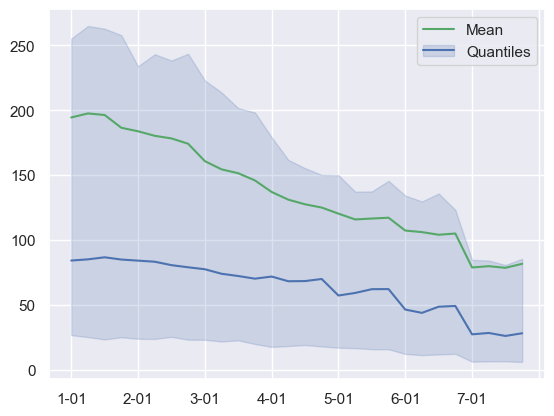

In [113]:
result = predictions.groupby(
    predictions["issue_date"].dt.month.astype("str")
    + "-"
    + predictions["issue_date"].dt.day.astype("str").str.pad(2, fillchar="0")
)["error"].describe()

display(result)

sns.set()
line_1 = plt.plot(result.index, result["mean"], "g-")
line_2 = plt.plot(result.index, result["50%"], "b")
fill_2 = plt.fill_between(result.index, result["25%"], result["75%"], color="b", alpha=0.2)
# plt.margins(x=0)

plt.legend([line_1[0], (line_2[0], fill_2)], ["Mean", "Quantiles"])
ax = plt.gca()
ax.xaxis.set_major_locator(plt.MaxNLocator(8))

,count,mean,std,min,25%,50%,75%,max
issue_date,,,,,,,,
1-01,260.0,0.329855,0.404085,0.034582,0.082149,0.180661,0.443746,2.630910
1-08,260.0,0.329762,0.397780,0.030633,0.083375,0.191668,0.426084,2.536139
1-15,260.0,0.331946,0.417065,0.029261,0.082944,0.176294,0.438751,2.683375
1-22,260.0,0.317117,0.393685,0.030793,0.084337,0.170731,0.411199,2.511627
2-01,260.0,0.315731,0.384982,0.027186,0.082614,0.158251,0.422355,2.353538
2-08,260.0,0.307941,0.368557,0.026517,0.081324,0.156596,0.422298,2.386148
2-15,260.0,0.305238,0.358045,0.027516,0.081451,0.166578,0.398019,2.288781
2-22,260.0,0.301190,0.359768,0.027630,0.082881,0.166220,0.411510,2.396018
3-01,260.0,0.279552,0.337809,0.024828,0.077807,0.157783,0.374884,2.309707


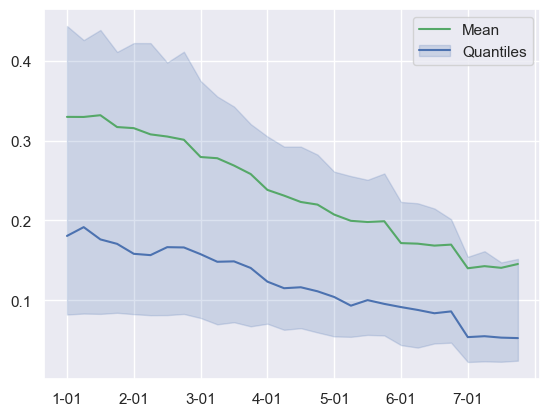

In [161]:
result = predictions.groupby(
    predictions["issue_date"].dt.month.astype("str")
    + "-"
    + predictions["issue_date"].dt.day.astype("str").str.pad(2, fillchar="0")
)["mape"].describe()

display(result)

sns.set()
line_1 = plt.plot(result.index, result["mean"], "g-")
line_2 = plt.plot(result.index, result["50%"], "b")
fill_2 = plt.fill_between(result.index, result["25%"], result["75%"], color="b", alpha=0.2)
# plt.margins(x=0)

plt.legend([line_1[0], (line_2[0], fill_2)], ["Mean", "Quantiles"])
ax = plt.gca()
ax.xaxis.set_major_locator(plt.MaxNLocator(8))

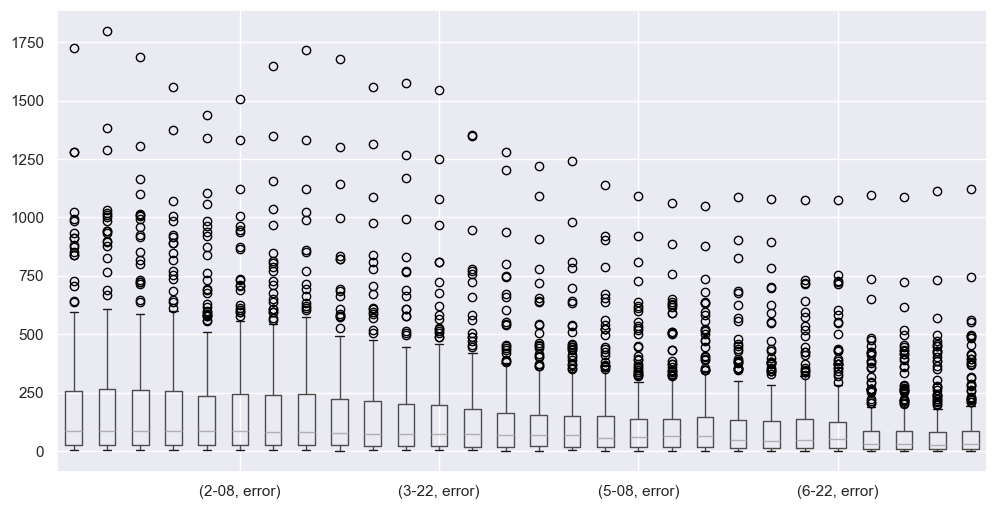

In [129]:
fig, ax = plt.subplots(figsize=(12, 6))
predictions.groupby(
    predictions["issue_date"].dt.month.astype("str")
    + "-"
    + predictions["issue_date"].dt.day.astype("str").str.pad(2, fillchar="0")
).boxplot(column="error", subplots=False, ax=ax)
ax.xaxis.set_major_locator(plt.MaxNLocator(5))

,count,mean,std,min,25%,50%,75%,max
site_id,,,,,,,,
owyhee_r_bl_owyhee_dam,28.0,0.647436,0.208491,0.350360,0.418646,0.633544,0.845140,0.933914
san_joaquin_river_millerton_reservoir,28.0,0.558463,0.111573,0.421348,0.459273,0.536304,0.663719,0.768218
american_river_folsom_lake,28.0,0.491768,0.104230,0.373933,0.403188,0.466271,0.586088,0.689998
merced_river_yosemite_at_pohono_bridge,28.0,0.430542,0.086946,0.326839,0.349304,0.426620,0.509600,0.599722
sweetwater_r_nr_alcova,28.0,0.421070,0.111683,0.228969,0.312628,0.452979,0.501750,0.593328
virgin_r_at_virtin,28.0,0.351754,0.107396,0.211958,0.246272,0.330743,0.451796,0.531360
colville_r_at_kettle_falls,28.0,0.294766,0.098077,0.138846,0.183868,0.333259,0.385110,0.395467
boysen_reservoir_inflow,28.0,0.261498,0.085035,0.103006,0.214502,0.271243,0.345268,0.376723
pecos_r_nr_pecos,28.0,0.224398,0.094224,0.084087,0.106700,0.256745,0.308550,0.356492


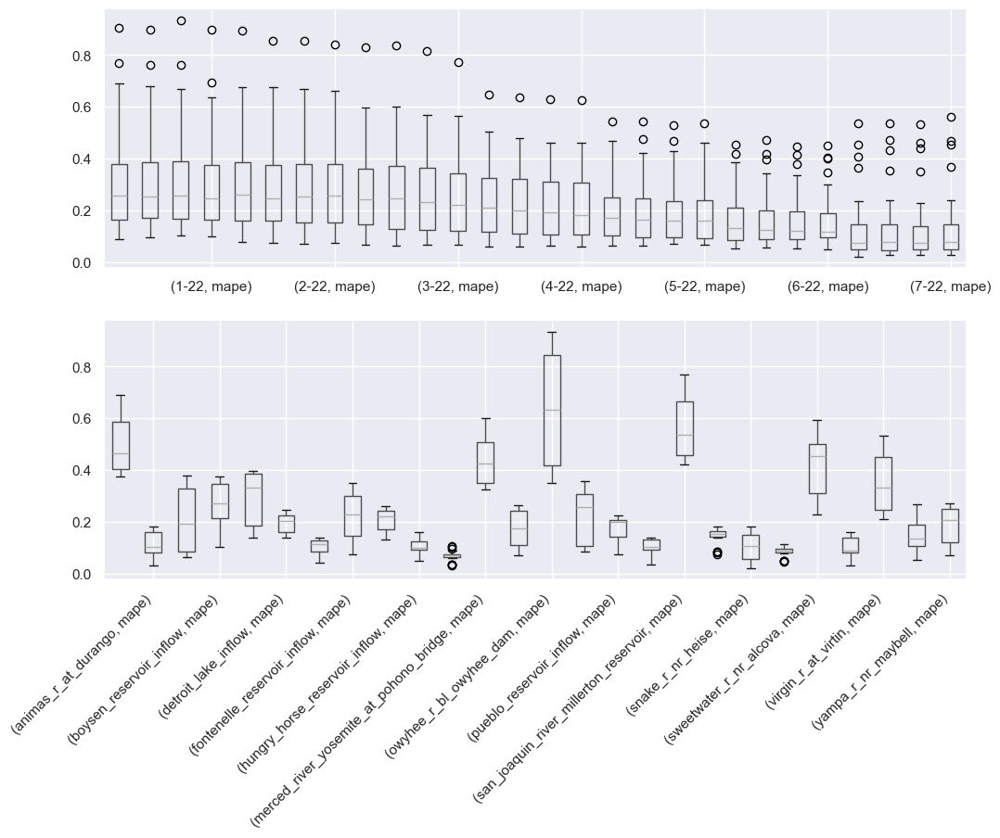

In [160]:
fig, ax = plt.subplots(nrows=2, figsize=(12, 8))

result = predictions.groupby(["issue_month", "site_id"]).mean().reset_index()
display(result.groupby("site_id")["mape"].describe().sort_values("mean", ascending=False))
result.groupby("issue_month").boxplot(column="mape", subplots=False, ax=ax[0])
ax[0].xaxis.set_major_locator(plt.MaxNLocator(7))
result.groupby("site_id").boxplot(column="mape", subplots=False, ax=ax[1])
ax[1].xaxis.set_major_locator(plt.MaxNLocator(15))
plt.setp(ax[1].get_xticklabels(), ha="right", rotation=45)

In [152]:
result.groupby("issue_month").boxplot(column="mape", subplots=False, ax=ax)
ax.xaxis.set_major_locator(plt.MaxNLocator(5))

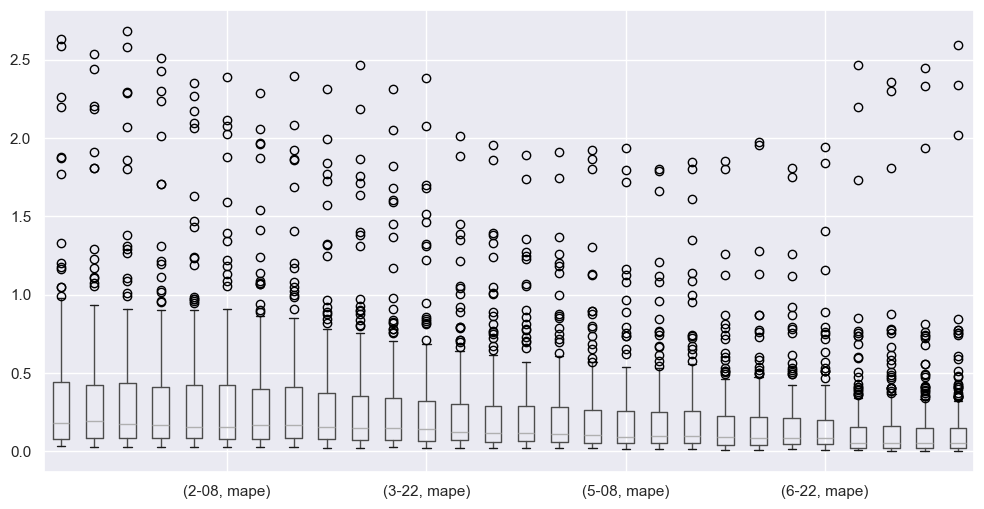

In [130]:
fig, ax = plt.subplots(figsize=(12, 6))
predictions.groupby(
    predictions["issue_date"].dt.month.astype("str")
    + "-"
    + predictions["issue_date"].dt.day.astype("str").str.pad(2, fillchar="0")
).boxplot(column="mape", subplots=False, ax=ax)
ax.xaxis.set_major_locator(plt.MaxNLocator(5))

# Generate Sub

In [165]:
assets = {}

from core.solution import predict
from pathlib import Path

for idx, row in tqdm(df_submission.iterrows()):
    pass
    # result = predict(row.site_id, row.issue_date, assets=assets, src_dir=Path("."), data_dir=Path("./data"), preprocessed_dir=Path("."))

result = predict(
    row.site_id,
    row.issue_date,
    assets=assets,
    src_dir=Path("."),
    data_dir=Path("./data"),
    preprocessed_dir=Path("."),
)

2023-12-29 12:10:33.746 | INFO     | core.config:<module>:25 - DATA_ROOT is /Users/nsarang/Nimas/water-supply-forecast-rodeo-runtime/data


KeyboardInterrupt: 

In [ ]:
# assets[(7, 22)]["test_features"]["predictions"]
result

# Copernicus Digital Elevation Model

In [23]:
import pystac_client
import planetary_computer

catalog = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier=planetary_computer.sign_inplace,
)

In [541]:
metadata_combined = pd.concat((metadata, df_supp_metadata[df_supp_metadata["longitude"] >= -130]))

lat_min = metadata_combined["latitude"].min()
lat_max = metadata_combined["latitude"].max()
lon_min = metadata_combined["longitude"].min()
lon_max = metadata_combined["longitude"].max()
pad = 1.5

In [542]:
us_bbox = [lon_min - pad, lat_min - pad, lon_max + pad, lat_max + pad]
us_bbox

[-125.16368, 31.148130000000002, -101.98213, 50.51194]

In [566]:
import planetary_computer
import rioxarray

grand_canyon = [-112.15, 36.05]
clat, clon = grand_canyon
radius = 0.5
grand_canyon_bbox = [clat - radius, clon - radius, clat + radius, clon + radius]


search = catalog.search(
    collections=["cop-dem-glo-90"],
    # GeoJSON object as intersects
    # intersects={"type": "Point", "coordinates": grand_canyon},
    bbox=us_bbox,
    # datetime="2005-12-01/2024-12-31"
)

items = search.get_all_items()
print(f"Returned {len(items)} items")

Returned 454 items


In [567]:
import os


def save_item(item):
    savepath = DATA_ROOT / "cdem" / (item.id + ".nc")
    if os.path.isfile(savepath):
        return
    signed_asset = planetary_computer.sign(item.assets["data"])
    tile = (
        rioxarray.open_rasterio(signed_asset.href)
        .squeeze()
        .drop("band")
        .coarsen({"y": 2, "x": 2})
        .mean()
    )
    tile.to_netcdf(savepath, mode="w", format="NETCDF4")


for item in tqdm(items):
    save_item(item)

  0%|          | 0/454 [00:00<?, ?it/s]

In [568]:
from matplotlib.colors import LightSource, LinearSegmentedColormap

# Datashader's Elevation colors
elevation_colors = [
    "aqua",
    "sandybrown",
    "limegreen",
    "green",
    "green",
    "darkgreen",
    "saddlebrown",
    "gray",
    "white",
]

# Color lookup dictionary
color_lookup = {
    "aliceblue": "#F0F8FF",
    "antiquewhite": "#FAEBD7",
    "aqua": "#00FFFF",
    "aquamarine": "#7FFFD4",
    "azure": "#F0FFFF",
    "beige": "#F5F5DC",
    "bisque": "#FFE4C4",
    "black": "#000000",
    "blanchedalmond": "#FFEBCD",
    "blue": "#0000FF",
    "blueviolet": "#8A2BE2",
    "brown": "#A52A2A",
    "burlywood": "#DEB887",
    "cadetblue": "#5F9EA0",
    "chartreuse": "#7FFF00",
    "chocolate": "#D2691E",
    "coral": "#FF7F50",
    "cornflowerblue": "#6495ED",
    "cornsilk": "#FFF8DC",
    "crimson": "#DC143C",
    "cyan": "#00FFFF",
    "darkblue": "#00008B",
    "darkcyan": "#008B8B",
    "darkgoldenrod": "#B8860B",
    "darkgray": "#A9A9A9",
    "darkgreen": "#006400",
    "darkgrey": "#A9A9A9",
    "darkkhaki": "#BDB76B",
    "darkmagenta": "#8B008B",
    "darkolivegreen": "#556B2F",
    "darkorange": "#FF8C00",
    "darkorchid": "#9932CC",
    "darkred": "#8B0000",
    "darksage": "#598556",
    "darksalmon": "#E9967A",
    "darkseagreen": "#8FBC8F",
    "darkslateblue": "#483D8B",
    "darkslategray": "#2F4F4F",
    "darkslategrey": "#2F4F4F",
    "darkturquoise": "#00CED1",
    "darkviolet": "#9400D3",
    "deeppink": "#FF1493",
    "deepskyblue": "#00BFFF",
    "dimgray": "#696969",
    "dimgrey": "#696969",
    "dodgerblue": "#1E90FF",
    "firebrick": "#B22222",
    "floralwhite": "#FFFAF0",
    "forestgreen": "#228B22",
    "fuchsia": "#FF00FF",
    "gainsboro": "#DCDCDC",
    "ghostwhite": "#F8F8FF",
    "gold": "#FFD700",
    "goldenrod": "#DAA520",
    "gray": "#808080",
    "green": "#008000",
    "greenyellow": "#ADFF2F",
    "grey": "#808080",
    "honeydew": "#F0FFF0",
    "hotpink": "#FF69B4",
    "indianred": "#CD5C5C",
    "indigo": "#4B0082",
    "ivory": "#FFFFF0",
    "khaki": "#F0E68C",
    "lavender": "#E6E6FA",
    "lavenderblush": "#FFF0F5",
    "lawngreen": "#7CFC00",
    "lemonchiffon": "#FFFACD",
    "lightblue": "#ADD8E6",
    "lightcoral": "#F08080",
    "lightcyan": "#E0FFFF",
    "lightgoldenrodyellow": "#FAFAD2",
    "lightgray": "#D3D3D3",
    "lightgreen": "#90EE90",
    "lightgrey": "#D3D3D3",
    "lightpink": "#FFB6C1",
    "lightsage": "#BCECAC",
    "lightsalmon": "#FFA07A",
    "lightseagreen": "#20B2AA",
    "lightskyblue": "#87CEFA",
    "lightslategray": "#778899",
    "lightslategrey": "#778899",
    "lightsteelblue": "#B0C4DE",
    "lightyellow": "#FFFFE0",
    "lime": "#00FF00",
    "limegreen": "#32CD32",
    "linen": "#FAF0E6",
    "magenta": "#FF00FF",
    "maroon": "#800000",
    "mediumaquamarine": "#66CDAA",
    "mediumblue": "#0000CD",
    "mediumorchid": "#BA55D3",
    "mediumpurple": "#9370DB",
    "mediumseagreen": "#3CB371",
    "mediumslateblue": "#7B68EE",
    "mediumspringgreen": "#00FA9A",
    "mediumturquoise": "#48D1CC",
    "mediumvioletred": "#C71585",
    "midnightblue": "#191970",
    "mintcream": "#F5FFFA",
    "mistyrose": "#FFE4E1",
    "moccasin": "#FFE4B5",
    "navajowhite": "#FFDEAD",
    "navy": "#000080",
    "oldlace": "#FDF5E6",
    "olive": "#808000",
    "olivedrab": "#6B8E23",
    "orange": "#FFA500",
    "orangered": "#FF4500",
    "orchid": "#DA70D6",
    "palegoldenrod": "#EEE8AA",
    "palegreen": "#98FB98",
    "paleturquoise": "#AFEEEE",
    "palevioletred": "#DB7093",
    "papayawhip": "#FFEFD5",
    "peachpuff": "#FFDAB9",
    "peru": "#CD853F",
    "pink": "#FFC0CB",
    "plum": "#DDA0DD",
    "powderblue": "#B0E0E6",
    "purple": "#800080",
    "red": "#FF0000",
    "rosybrown": "#BC8F8F",
    "royalblue": "#4169E1",
    "saddlebrown": "#8B4513",
    "sage": "#87AE73",
    "salmon": "#FA8072",
    "sandybrown": "#FAA460",
    "seagreen": "#2E8B57",
    "seashell": "#FFF5EE",
    "sienna": "#A0522D",
    "silver": "#C0C0C0",
    "skyblue": "#87CEEB",
    "slateblue": "#6A5ACD",
    "slategray": "#708090",
    "slategrey": "#708090",
    "snow": "#FFFAFA",
    "springgreen": "#00FF7F",
    "steelblue": "#4682B4",
    "tan": "#D2B48C",
    "teal": "#008080",
    "thistle": "#D8BFD8",
    "tomato": "#FF6347",
    "turquoise": "#40E0D0",
    "violet": "#EE82EE",
    "wheat": "#F5DEB3",
    "white": "#FFFFFF",
    "whitesmoke": "#F5F5F5",
    "yellow": "#FFFF00",
    "yellowgreen": "#9ACD32",
}

# Convert color names to hex
elevation_hex_colors = [color_lookup[color] for color in elevation_colors]

# Create a custom colormap
elevation_cmap = LinearSegmentedColormap.from_list("elevation", elevation_hex_colors)

In [569]:
# Assuming 'ds' is your xarray Dataset
data = xr.open_mfdataset((DATA_ROOT / "cdem" / "raw").glob("*.nc"))
variable_name = list(data.data_vars)[0]  # Get the name of the single variable
data = data[variable_name]  # Extract the DataArray
data

<xarray.DataArray '__xarray_dataarray_variable__' (y: 12000, x: 25000)>
dask.array<concatenate, shape=(12000, 25000), dtype=float32, chunksize=(600, 1000), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 -126.0 -126.0 -126.0 ... -101.0 -101.0 -101.0
  * y            (y) float64 51.0 51.0 51.0 50.99 50.99 ... 31.01 31.0 31.0 31.0
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Point

In [582]:
data_orig = data
data_orig

<xarray.DataArray '__xarray_dataarray_variable__' (y: 12000, x: 25000)>
dask.array<concatenate, shape=(12000, 25000), dtype=float32, chunksize=(600, 1000), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 -126.0 -126.0 -126.0 ... -101.0 -101.0 -101.0
  * y            (y) float64 51.0 51.0 51.0 50.99 50.99 ... 31.01 31.0 31.0 31.0
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Point

In [377]:
# data = data_orig.sel(x=slice(-118, -117), y=slice(52, 50))
# data

# data = data_orig.coarsen(x=4, y=4, boundary='trim').mean()

# data_orig.x.to_numpy() - np.roll(data_orig.x.to_numpy(), 1)

# pad = 3
# data = data_orig.sel(
#     x=slice(grand_canyon[0] - pad, grand_canyon[0] + pad),
#     y=slice(grand_canyon[1] + pad, grand_canyon[1] - pad),
# )
# .coarsen(x=2, y=2, boundary='trim').mean()

In [581]:
from pyproj import Transformer

raw_coordindates = metadata_combined[["latitude", "longitude"]].values
latitudes, longitudes = raw_coordindates.T
transformer = Transformer.from_proj("EPSG:4326", "ESRI:102004", always_xy=True)  # EPSG:5070
x, y = transformer.transform(longitudes, latitudes)
coordindates = np.stack((x, y), axis=1)

In [583]:
from rasterio.enums import Resampling

data_orig_meter = (
    data_orig.rio.write_nodata(np.nan)
    .rio.write_crs("EPSG:4326")
    .rio.reproject(
        "ESRI:102004", resampling=Resampling.average, nodata=np.nan  # Set NaN as NoData
    )
)

In [614]:
index = 13
print(raw_coordindates[index])
cx, cy = coordindates[index]
# cx, cy = transformer.transform(*grand_canyon)
cr = 40 * 1000
data = data_orig_meter.sel(x=slice(cx - cr, cx + cr), y=slice(cy + cr, cy - cr))

[  42.02778 -110.06667]


In [607]:
# data_orig_meter.to_dataset(name="dem").to_netcdf(
#     DATA_ROOT / "cdem" / "processed.nc",
#     mode="w",
#     format="NETCDF4",
#     encoding={"dem": {"zlib": True}},
# )

In [613]:
# data = data_orig_meter.coarsen(x=4, y=4, boundary='trim').mean()

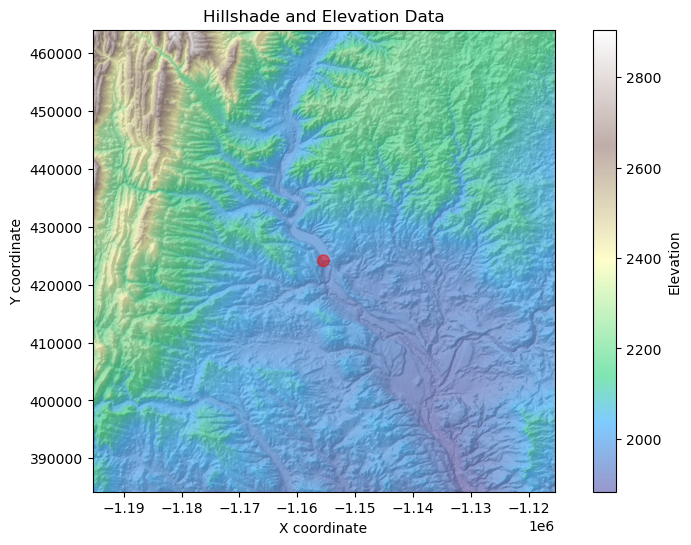

In [615]:
import matplotlib.pyplot as plt
from matplotlib.colors import LightSource
import numpy as np

# Assuming 'data' is your elevation data in an xarray.DataArray
# Convert xarray.DataArray to numpy array if it's not already
data_np = data.to_numpy().copy() if hasattr(data, "values") else data
data_np[np.isnan(data_np)] = 0


# Create a light source object
ls = LightSource(azdeg=315, altdeg=45)

# Create hillshade
hillshade = ls.hillshade(data_np)

# Create a color map (this is a basic version, you might need to adjust it to match 'Elevation' colormap)
cmap = plt.cm.terrain

# Define the extent of the plot using the coordinates
x = data.coords["x"].values
y = data.coords["y"].values
extent = [x.min(), x.max(), y.min(), y.max()]


# Overlay the hillshade onto the data
plt.figure(figsize=(10, 6))
plt.imshow(
    hillshade, cmap="gray", alpha=0.5, extent=extent
)  # Adjust alpha for hillshade intensity
plt.imshow(data_np, cmap=cmap, alpha=0.5, extent=extent)  # Adjust alpha for data overlay

# # If 'data' has coordinate labels, you can use them for axes labeling
# if hasattr(data, 'coords') and 'x' in data.coords and 'y' in data.coords:
#     plt.xticks(np.arange(len(data.coords['x'])), data.coords['x'].values, rotation='vertical')
#     plt.yticks(np.arange(len(data.coords['y'])), data.coords['y'].values)

from matplotlib.patches import Circle

# Specify the latitude and longitude for the circle
circle_lon, circle_lat = cx, cy  # Replace with your coordinates
circle_radius = 1000  # Degrees, adjust the size as needed

# Create a circle at the specified location
circle = Circle((circle_lon, circle_lat), circle_radius, color="red", alpha=0.5)

# Add the circle to the plot
ax = plt.gca()
ax.add_patch(circle)

plt.colorbar(label="Elevation")
plt.title("Hillshade and Elevation Data")
plt.xlabel("X coordinate")
plt.ylabel("Y coordinate")
plt.show()

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A Priority-Flood+Epsilon
C Barnes, R., Lehman, C., Mulla, D., 2014. Priority-flood: An optimal depression-filling and watershed-labeling algorithm for digital elevation models. Computers & Geosciences 62, 117–127. doi:10.1016/j.cageo.2013.04.024

c topology = D8
p Setting up boolean flood array matrix...
p Adding cells to the priority queue...
p Performing Priority-Flood+Epsilon...
t succeeded in 0.0652678 s=================== ] (99% - 0.0s - 1 threads)
m Cells processed = 534361
m Cells in pits = 13121
W W In assigning negligible gradients to depressions, some depressions rose above the surrounding cells. This implies that a larger storage type should be used. The problem occured for 8 of 534361.


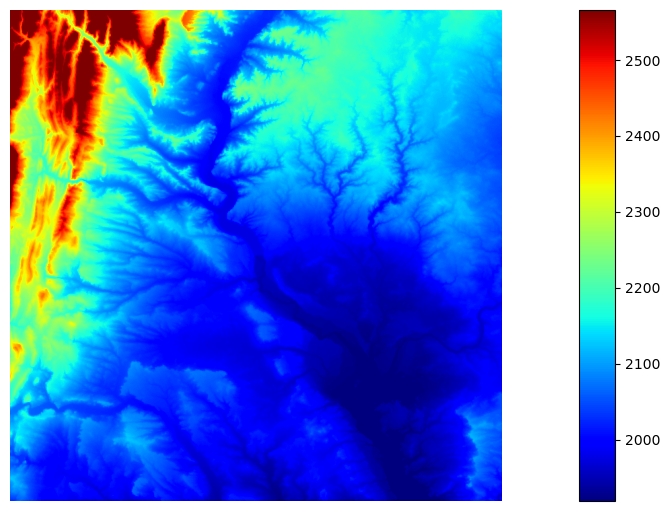

Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)
Warning! No geotransform defined. Choosing a standard one! (Top left cell's top let corner at <0,0>; cells are 1x1.)



A O'Callaghan (1984)/Marks (1984) D8/D4 Flow Accumulation
C O'Callaghan, J.F., Mark, D.M., 1984. The Extraction of Drainage Networks from Digital Elevation Data. Computer vision, graphics, and image processing 28, 323--344.

c topology = D8
[================================================= ] (99% - 0.0s - 1 threads)
A Generic Flow Accumulation Algorithm
p Creating dependencies array...

d Source cells found = 179797
p Calculating flow accumulation...
t Wall-time       = 0.0226546 s============== ] (99% - 0.0s - 1 threads)


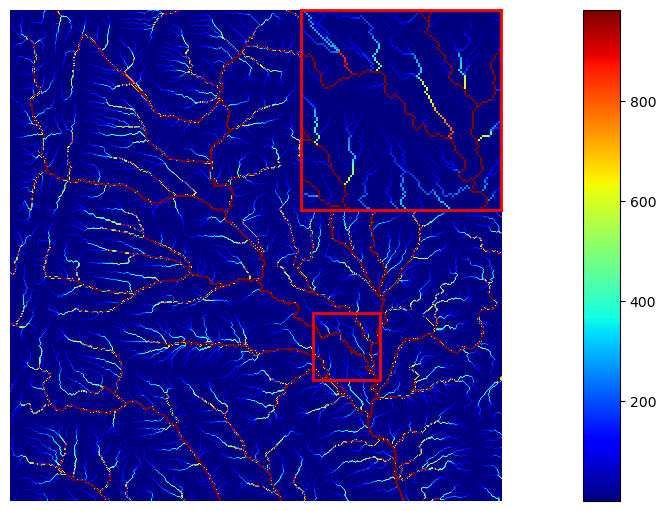

In [616]:
import pystac_client
import planetary_computer
import rioxarray
import richdem as rd
import matplotlib.pyplot as plt

# Assuming 'data' is your xarray DataArray
bounds = data.rio.bounds()
extent = [bounds[0], bounds[2], bounds[1], bounds[3]]  # Format: [min_x, max_x, min_y, max_y]

# Convert the xarray DataArray to a numpy array
dem_np = data.values

# Handle no data values if necessary
dem_np[data.isnull()] = -9999  # or an appropriate no-data value

# Convert the numpy array to a richdem DEM object
dem_rd = rd.rdarray(dem_np, no_data=-9999)

# Fill depressions in DEM
dem_filled = rd.FillDepressions(dem_rd, epsilon=True)
rd.rdShow(dem_filled, ignore_colours=[0], axes=False, cmap="jet", figsize=(8, 5.5))

accum_d8 = rd.FlowAccumulation(dem_filled, method="D8")
d8_fig = rd.rdShow(
    accum_d8, zxmin=450, zxmax=550, zymin=550, zymax=450, figsize=(8, 5.5), axes=False, cmap="jet"
)

# BasinATLAS

In [539]:
import fiona
import geopandas as gpd

# Path to your geodatabase file
gdb_path = "data/BasinATLAS_Data_v10.gdb/BasinATLAS_v10.gdb"

# List all layers in the geodatabase using fiona.listlayers()
layers = fiona.listlayers(gdb_path)
print("Layers: ", layers, "\n")

for layer in layers:
    # Open a specific layer
    with fiona.open(gdb_path, layer=layer) as lyr:
        # Print information about the layer
        print(f"Layer: {layer}")
        print(f"Number of features: {len(lyr)}")
        print(f"Geometry type: {lyr.schema['geometry']}")
        print(f"Number of properties: {len(lyr.schema['properties'])}")
        print(f"Properties: {lyr.schema['properties']}")
        print(f"CRS: {lyr.crs}\n")

Layers:  ['BasinATLAS_v10_lev01', 'BasinATLAS_v10_lev02', 'BasinATLAS_v10_lev03', 'BasinATLAS_v10_lev04', 'BasinATLAS_v10_lev05', 'BasinATLAS_v10_lev06', 'BasinATLAS_v10_lev07', 'BasinATLAS_v10_lev08', 'BasinATLAS_v10_lev09', 'BasinATLAS_v10_lev10', 'BasinATLAS_v10_lev11', 'BasinATLAS_v10_lev12'] 

Layer: BasinATLAS_v10_lev01
Number of features: 10
Geometry type: MultiPolygon
Number of properties: 296
Properties: {'HYBAS_ID': 'float', 'NEXT_DOWN': 'float', 'NEXT_SINK': 'float', 'MAIN_BAS': 'float', 'DIST_SINK': 'float', 'DIST_MAIN': 'float', 'SUB_AREA': 'float', 'UP_AREA': 'float', 'PFAF_ID': 'int', 'ENDO': 'int', 'COAST': 'int', 'ORDER_': 'int', 'SORT': 'float', 'dis_m3_pyr': 'float', 'dis_m3_pmn': 'float', 'dis_m3_pmx': 'float', 'run_mm_syr': 'int', 'inu_pc_smn': 'int', 'inu_pc_umn': 'int', 'inu_pc_smx': 'int', 'inu_pc_umx': 'int', 'inu_pc_slt': 'int', 'inu_pc_ult': 'int', 'lka_pc_sse': 'int', 'lka_pc_use': 'int', 'lkv_mc_usu': 'int', 'rev_mc_usu': 'int', 'dor_pc_pva': 'int', 'ria_ha

In [543]:
import fiona
from shapely.geometry import box, shape

# Read only features within the bounding box
with fiona.open(gdb_path, layer="BasinATLAS_v10_lev04") as src:
    num_features = len(src)
    filtered_features = [
        feature for feature in tqdm(src) if shape(feature["geometry"]).intersects(box(*us_bbox))
    ]
    print(f"Retefntion: {len(filtered_features) / num_features * 100: .1f}%")
    gdf4 = gpd.GeoDataFrame.from_features(filtered_features)

  0%|          | 0/1342 [00:00<?, ?it/s]

Retention:  4.2%


In [544]:
import fiona
from shapely.geometry import box, shape

# Read only features within the bounding box
with fiona.open(gdb_path, layer="BasinATLAS_v10_lev10") as src:
    num_features = len(src)
    filtered_features = [
        feature for feature in tqdm(src) if shape(feature["geometry"]).intersects(box(*us_bbox))
    ]
    print(f"Retention: {len(filtered_features) / num_features * 100: .1f}%")
    gdf10 = gpd.GeoDataFrame.from_features(filtered_features)

  0%|          | 0/941012 [00:00<?, ?it/s]

Retention:  2.8%


In [621]:
[
    x
    for x in gdf10.columns
    if any(
        [
            x.startswith(prefix)
            for prefix in [
                "ele", # Elevation
                "ria_ha", # River Area
                "riv_tc", # River Volume
                "slp_dg", # Terrain Slope
                "sgr_dk", # Stream Gradient
                "glc_cl", # Land Cover Classes
                "gla_pc", # Glacier Extent
                "cly_pc", # Clay Fraction in Soil
                "snd_pc", # Sand Fraction in Soil
                "lit_cl", # Lithological Classes 
            ]
        ]
    )
]

['ria_ha_ssu',
 'ria_ha_usu',
 'riv_tc_ssu',
 'riv_tc_usu',
 'ele_mt_sav',
 'ele_mt_uav',
 'ele_mt_smn',
 'ele_mt_smx',
 'slp_dg_sav',
 'slp_dg_uav',
 'sgr_dk_sav',
 'glc_cl_smj',
 'gla_pc_sse',
 'gla_pc_use',
 'cly_pc_sav',
 'cly_pc_uav',
 'snd_pc_sav',
 'snd_pc_uav',
 'lit_cl_smj']

In [631]:
plt_col = "slp_dg_sav"
plt_col = "glc_cl_smj"
plt_col = "snd_pc_uav"
plt_col = "riv_tc_ssu"

In [632]:
gdf4["SUB_AREA"].sum(), gdf10["SUB_AREA"].sum()

(6639417.0, 3720496.5999999996)

<Axes: >

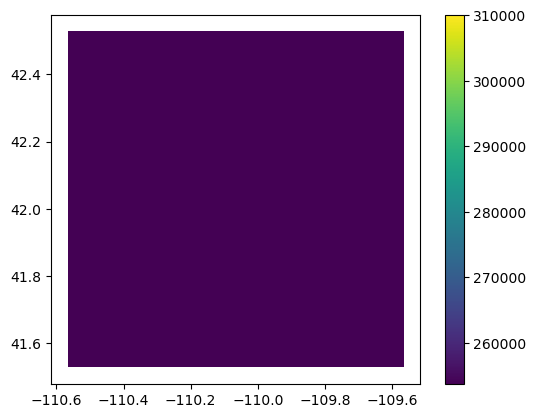

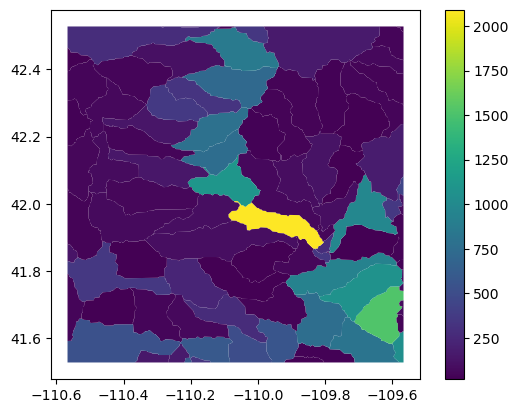

In [679]:
raw_coordindates = metadata_combined[["longitude", "latitude"]].values

index = 13
lon, lat = raw_coordindates[index]
bbox = center2bbox(lon, lat, cr=0.5)

bbox_filter(gdf4, bbox).plot(column=plt_col, cmap="viridis", legend=True)
bbox_filter(gdf10, bbox).plot(column=plt_col, cmap="viridis", legend=True)

In [ ]:
gdf4.plot(column=plt_col, cmap="viridis", legend=True)
gdf10.plot(column=plt_col, cmap="viridis", legend=True)

In [ ]:
from core.data.geometry import haversine_distance_coords
haversine_distance_coords(*bbox) / 2 ** 0.5

In [24]:
gdf[list(gdf.columns[:10]) + ["ele_mt_sav", "ele_mt_uav", "ele_mt_smn", "ele_mt_smx", "geometry"]]

,HYBAS_ID,NEXT_DOWN,NEXT_SINK,MAIN_BAS,DIST_SINK,DIST_MAIN,SUB_AREA,UP_AREA,PFAF_ID,ENDO,ele_mt_sav,ele_mt_uav,ele_mt_smn,ele_mt_smx,geometry
0,1.050000e+09,0.0,1.050000e+09,1.050000e+09,0.0,0.0,45567.0,45567.0,11101,0,380,5,-2,2026,"MULTIPOLYGON (((35.17778 24.64583, 35.17279 24..."
1,1.050001e+09,0.0,1.050001e+09,1.050001e+09,0.0,0.0,11678.4,11678.5,11102,0,450,450,0,1381,"MULTIPOLYGON (((35.14167 22.58333, 35.15316 22..."
2,1.050001e+09,0.0,1.050001e+09,1.050001e+09,0.0,0.0,5524.6,5524.6,11103,0,312,3,-5,1523,"MULTIPOLYGON (((35.92083 22.50417, 35.91424 22..."
3,1.050002e+09,0.0,1.050002e+09,1.050002e+09,0.0,0.0,42400.5,42400.5,11104,0,573,573,-2,2124,"MULTIPOLYGON (((35.24167 21.59167, 35.24202 21..."
4,1.050002e+09,0.0,1.050002e+09,1.050002e+09,0.0,0.0,16198.5,16198.5,11105,0,353,0,-5,2095,"MULTIPOLYGON (((36.63194 22.28750, 36.62860 22..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4729,9.050017e+09,0.0,9.050017e+09,9.050017e+09,0.0,0.0,76520.2,76522.3,91480,0,1743,1757,-382,4899,"MULTIPOLYGON (((-39.90417 78.41667, -39.90508 ..."
4730,9.050017e+09,0.0,9.050017e+09,9.050017e+09,0.0,0.0,19205.7,19205.7,91490,0,453,56,2,2663,"MULTIPOLYGON (((-17.76806 81.90000, -17.83255 ..."
4731,9.050018e+09,0.0,9.050018e+09,9.050018e+09,0.0,0.0,7610.6,7610.6,91150,0,495,331,0,1885,"MULTIPOLYGON (((-23.14306 73.21667, -23.17428 ..."
4732,9.050018e+09,0.0,9.050018e+09,9.050018e+09,0.0,0.0,8668.4,8668.4,91300,0,642,52,0,1862,"MULTIPOLYGON (((-54.16806 69.49167, -54.17398 ..."
